In [8]:
import cv2

class Camera(object):
    
    def __init__(self):
        self.ret = None
        self.mtx = None
        self.dist = None
        self.rvect = None
        self.tvect = None
        self.filenames = []
        self.images = []
        
    def _findCorners(self, filenames, nx, ny, print_log):
        objpoints = []
        imgpoints = []
        n_notfound = 0
        
        objp = np.zeros((nx*ny, 3), np.float32)
        objp[:,:2] = np.mgrid[0:nx, 0:ny].T.reshape(-1, 2)
        
        for filename in filenames:
            image = cv2.imread(filename)
            bw_image = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)

            found, corners = cv2.findChessboardCorners(bw_image, (nx,ny), None)

            if found == True:
                imgpoints.append(corners)
                objpoints.append(objp)
                if print_log == True:
                    print('Corners found in', filename)
            else:
                n_notfound += 1
                if print_log == True:
                    print('Corners not found in', filename)

            cv2.drawChessboardCorners(image, (nx,ny), corners, True)
            self.images.append(image)
            self.filenames.append(filename)

        print('Corners found in %d images' % len(self.images))
        print('Corners not found in %d images' % n_notfound)
        return objpoints, imgpoints, self.images

    def calibrate(self, filenames, wcorners, hcorners, print_log=False):
        objpoints, imgpoints, self.images = self._findCorners(filenames, wcorners, hcorners, print_log)
        self.ret, self.mtx, self.dist, self.rvect, self.tvect = cv2.calibrateCamera(objpoints, imgpoints, self.images[0].shape[0:2], None, None)
        
    def undistort(self, image):
        undistorted_image = cv2.undistort(image, self.mtx, self.dist, None, self.mtx)
        return undistorted_image
    
    # Define a function that takes an image, number of x and y points, 
    # camera matrix and distortion coefficients
    def _warp(self, image, src, dst):
        # Given src and dst points, calculate the perspective transform matrix
        M = cv2.getPerspectiveTransform(src, dst)
        # Grab the image shape
        image_size = (image.shape[1], image.shape[0])
        # Warp the image using OpenCV warpPerspective()
        warped = cv2.warpPerspective(image, M, image_size)
        # Return the resulting image and matrix
        return warped, M
    
    # Define a function that transforms an image to birds view
    # For the initial simplicity of the algorithm we define 
    # vanishing poing in the center of input image
    def bird_view(self, image):
        h = image.shape[0]
        w = image.shape[1]
        hk = 3.168/4
        wk = 3/4
        # apply warp transform
        src = np.float32([[int(w*(1-wk)), int(h*hk)], 
                          [int(w*wk), int(h*hk)],
                          [w, h],
                          [0, h]])
        dst = np.float32([[0, int(h*hk)],
                          [w, int(h*hk)],
                          [w, h],
                          [0, h]])
        image, M = self._warp(image, src, dst)
        return image, M
    
def plot_two_images(image1, title1, image2, title2):
    fig = plt.figure(num=None, figsize=(8, 6), dpi=160)
    plt.subplot(121)
    plt.imshow(image1)
    plt.title(title1)
    plt.subplot(122)
    plt.imshow(image2)
    plt.title(title2)
    fig.tight_layout()
    plt.show()
    
def plot_one_image(image, title):
    fig = plt.figure(num=None, figsize=(8, 6), dpi=160)
    plt.subplot(111)
    plt.imshow(image)
    plt.title(title)
    fig.tight_layout()
    plt.show()

In [9]:
import numpy as np

class Thresholder(object):

    # Define a function that takes an image, gradient orientation,
    # and threshold min / max values.
    def abs_sobel_thresh(self, img, orient='x', thresh=(0, 255)):
        # Convert to grayscale
        gray = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)
        # Apply x or y gradient with the OpenCV Sobel() function
        # and take the absolute value
        if orient == 'x':
            abs_sobel = np.absolute(cv2.Sobel(gray, cv2.CV_64F, 1, 0))
        if orient == 'y':
            abs_sobel = np.absolute(cv2.Sobel(gray, cv2.CV_64F, 0, 1))
        # Rescale back to 8 bit integer
        scaled_sobel = np.uint8(255*abs_sobel/np.max(abs_sobel))
        # Create a copy and apply the threshold
        binary_output = np.zeros_like(scaled_sobel)
        # Here I'm using inclusive (>=, <=) thresholds, but exclusive is ok too
        binary_output[(scaled_sobel >= thresh[0]) & (scaled_sobel <= thresh[1])] = 1

        # Return the result
        return binary_output

    # Define a function to return the magnitude of the gradient
    # for a given sobel kernel size and threshold values
    def mag_thresh(self, img, sobel_kernel=3, mag_thresh=(0, 255)):
        # Convert to grayscale
        gray = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)
        # Take both Sobel x and y gradients
        sobelx = cv2.Sobel(gray, cv2.CV_64F, 1, 0, ksize=sobel_kernel)
        sobely = cv2.Sobel(gray, cv2.CV_64F, 0, 1, ksize=sobel_kernel)
        # Calculate the gradient magnitude
        gradmag = np.sqrt(sobelx**2 + sobely**2)
        # Rescale to 8 bit
        scale_factor = np.max(gradmag)/255 
        gradmag = (gradmag/scale_factor).astype(np.uint8) 
        # Create a binary image of ones where threshold is met, zeros otherwise
        binary_output = np.zeros_like(gradmag)
        binary_output[(gradmag >= mag_thresh[0]) & (gradmag <= mag_thresh[1])] = 1

        # Return the binary image
        return binary_output

    # Define a function to threshold an image for a given range and Sobel kernel
    def dir_threshold(self, img, sobel_kernel=3, thresh=(0, np.pi/2)):
        # Grayscale
        gray = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)
        # Calculate the x and y gradients
        sobelx = cv2.Sobel(gray, cv2.CV_64F, 1, 0, ksize=sobel_kernel)
        sobely = cv2.Sobel(gray, cv2.CV_64F, 0, 1, ksize=sobel_kernel)
        # Take the absolute value of the gradient direction, 
        # apply a threshold, and create a binary image result
        absgraddir = np.arctan2(np.absolute(sobely), np.absolute(sobelx))
        binary_output =  np.zeros_like(absgraddir)
        binary_output[(absgraddir >= thresh[0]) & (absgraddir <= thresh[1])] = 1

        # Return the binary image
        return binary_output

    def s_channel_thresh(self, image, thresh=(0,255)):
        # Convert to HLS color space and separate the S channel
        # Note: img is the undistorted image
        hls = cv2.cvtColor(image, cv2.COLOR_RGB2HLS)
        s_channel = hls[:,:,2]
        # apply a threshold, and create a binary image result
        s_binary = np.zeros_like(s_channel)
        s_binary[(s_channel >= thresh[0]) & (s_channel <= thresh[1])] = 1

        # Return the binary image
        return s_binary
    
    def apply(self, image, image_log = False):
        # Apply each of the Sobel gradient thresholding functions
        gradx = self.abs_sobel_thresh(image, orient='x', thresh=(20, 100))
        if image_log == True:
            print('Gradx')
            plt.imshow(gradx, cmap='gray')
            plt.show()
        grady = self.abs_sobel_thresh(image, orient='y', thresh=(20, 100))
        if image_log == True:
            print('Grady')
            plt.imshow(grady, cmap='gray')
            plt.show()
        mag_binary = self.mag_thresh(image, sobel_kernel=3, mag_thresh=(30, 100))
        if image_log == True:
            print('Magnitude')
            plt.imshow(mag_binary, cmap='gray')
            plt.show()
        dir_binary = self.dir_threshold(image, sobel_kernel=15, thresh=(0.7, 1.3))
        if image_log == True:
            print('Directional')
            plt.imshow(dir_binary, cmap='gray')
            plt.show()
        # Combine gradients
        grad_binary = np.zeros_like(dir_binary)
        grad_binary[((gradx == 1) & (grady == 1)) | ((mag_binary == 1) & (dir_binary == 1))] = 1
        if image_log == True:
            print('Combined')
            plt.imshow(grad_binary, cmap='gray')
            plt.show()
            
        # Apply S color channel thresholding functions
        color_binary = self.s_channel_thresh(image, thresh=(170, 255))
        if image_log == True:
            print('Color')
            plt.imshow(color_binary, cmap='gray')
            plt.show()
        # Stack each channel to view their individual contributions in green and blue respectively
        stack_binary = np.dstack(( np.zeros_like(grad_binary), grad_binary, color_binary))
        if image_log == True:
            print('Stack')
            plt.imshow(stack_binary)
            plt.show()
            
        # Combine the two binary thresholds
        combined_binary = np.zeros_like(grad_binary)        
        combined_binary[((color_binary == 1) | (grad_binary == 1))] = 1
        if image_log == True:
            print('Combined')
            plt.imshow(combined_binary, cmap='gray')
            plt.show()
            
        return combined_binary

In [10]:
class LaneFinder(object):
    
    def define_peaks(self, image, regularization=1.5): 
        
        histogram = np.sum(image, axis=0)
        
        # regularization
        max_value = histogram[np.argmax(histogram)]
        for i in range(len(histogram)):
            if histogram[i] < max_value/regularization:
                histogram[i] = 0
            else:
                histogram[i] -= max_value/regularization
                
        # left part of the image
        half_length = int(len(histogram)/2)
        x_left = np.argmax(histogram[0:half_length])
        if x_left == 0:
            x_left = None
        
        # right part of the image
        x_right = half_length + np.argmax(histogram[half_length:len(histogram)])
        if x_right == half_length:
            x_right = None
            
        return x_left, x_right 

In [11]:
class LaneFindingAgent(object):
    
    def __init__(self, camera, thresholder, lane_finder):
        self.camera = camera        
        self.thresholder = thresholder
        self.lane_finder = lane_finder
        
    def bird_image(self, image, image_log=False):
        if image_log == True:
            print('Original image')
            plt.imshow(image)
            plt.show()
        bird_view, M = self.camera.bird_view(image)
        if image_log == True:
            print('Bird view')
            plt.imshow(bird_view)
            plt.show()
        binary_image = self.thresholder.apply(image, image_log=False)
        binary_image, M = self.camera.bird_view(binary_image)
        if image_log == True:
            print('Bird view')
            plt.imshow(cv2.cvtColor(binary_image.astype(np.float32), cv2.COLOR_GRAY2RGB))
            plt.show()
        
        return binary_image, M
    
    def histogram_peaks(self, image, y_from, y_to):
        histogram = np.sum(image[y_from:y_to], axis = 0)
        x_left = np.argmax(histogram[:int(len(histogram)/2)])
        x_right = int(len(histogram)/2) + np.argmax(histogram[int(len(histogram)/2):len(histogram)])
        return x_left, x_right
    
    def zip_image(self, image, y_from, y_to, x, distance):
#         plt.imshow(image)
        xs = []
        ys = []
        x_from = np.maximum(x - distance, 0)
        x_to = np.minimum(x + distance, image.shape[1])
#         print(np.maximum(x - distance, 0), np.minimum(x + distance, image.shape[1]))
        for y in range(y_from, y_to, 1):
#             plt.plot([x_from], [y], '.', color='yellow')
#             plt.plot([x_to], [y], '.', color='yellow')
            for x in range(x_from, x_to):
                if image[y, x] > 0:
                    xs.append(x)
                    ys.append(y)
#         plt.show()
        return xs, ys
    
    def remove_noise(self, image, y_from, y_to, x_left, x_right, distance):
        for y in range(y_from, y_to, 1):
            for x in range(np.maximum(x_left - distance, 0)):
                image[y, x] = 0
            if x_left + distance < x_right - distance:
                for x in range(x_left + distance, x_right - distance, 1):
                    image[y, x] = 0
            for x in range(np.minimum(x_right + distance, image.shape[1]), image.shape[1], 1):
                image[y, x] = 0
        
        xs_left, ys_left = self.zip_image(image, 
                                       y_from=y_from, 
                                       y_to=y_to, 
                                       x=x_left, 
                                       distance=distance)
        
        xs_right, ys_right = self.zip_image(image, 
                                       y_from=y_from, 
                                       y_to=y_to, 
                                       x=x_right, 
                                       distance=distance)
        
        return image, xs_left, ys_left, xs_right, ys_right
            
    def polyfit(self, xs, ys):
        fit = np.polyfit(ys, xs, 2)
        fitx = fit[0]*ys**2 + fit[1]*ys + fit[2]
        return fit, fitx
    
    def curverad(self, ys, fit):
        ys_eval = np.max(ys)
        curverad = ((1 + (2*fit[0]*ys_eval + fit[1])**2)**1.5) / np.absolute(2*fit[0])
        return curverad
    
    def stack(self, input_image, image, left_fitx, leftys, right_fitx, rightys, M):
        # Create an image to draw the lines on
        warp_zero = np.zeros_like(image).astype(np.uint8)
        color_warp = np.dstack((warp_zero, warp_zero, warp_zero))

        # Recast the x and y points into usable format for cv2.fillPoly()
        pts_left = np.array([np.transpose(np.vstack([left_fitx, leftys]))])
        pts_right = np.array([np.flipud(np.transpose(np.vstack([right_fitx, rightys])))])
        pts = np.hstack((pts_left, pts_right))

        # Draw the lane onto the warped blank image
        cv2.fillPoly(color_warp, np.int_([pts]), (0,255, 0))

        # Warp the blank back to original image space using inverse perspective matrix (Minv)
        newwarp = cv2.warpPerspective(color_warp, np.linalg.inv(M), (image.shape[1], image.shape[0])) 
        # Combine the result with the original image
        result = cv2.addWeighted(input_image, 1, newwarp, 0.3, 0)
        
        return result

In [12]:
import glob
import matplotlib.pyplot as plt
import math
import matplotlib.image as mpimg
from moviepy.editor import VideoFileClip
%matplotlib inline

# Camera
camera = Camera()

# Thresholder
thresholder = Thresholder()

# LaneFinder
lane_finder = LaneFinder()

# LaneFindingAgent
agent = LaneFindingAgent(camera, thresholder, lane_finder)

In [13]:
# Calibrate camera
camera.calibrate(glob.glob("camera_cal/calibration*.jpg"), 9, 6)

Corners found in 20 images
Corners not found in 3 images


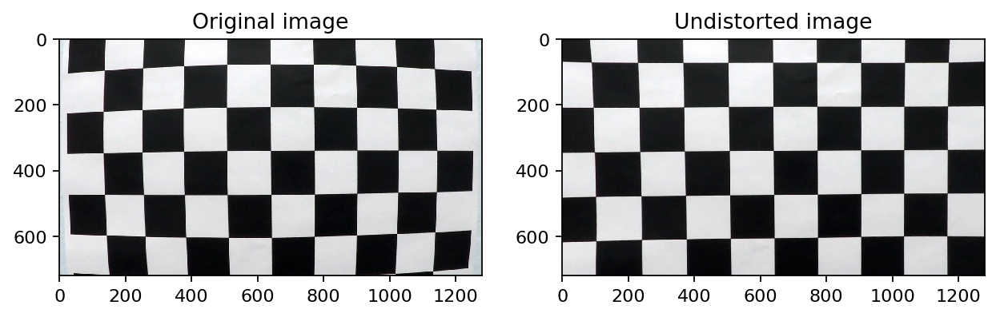

In [14]:
# Provide an example of a distortion corrected calibration image
image = cv2.imread('camera_cal/calibration1.jpg')
undistorted_image = camera.undistort(image)
plot_two_images(image, 'Original image', undistorted_image, 'Undistorted image')

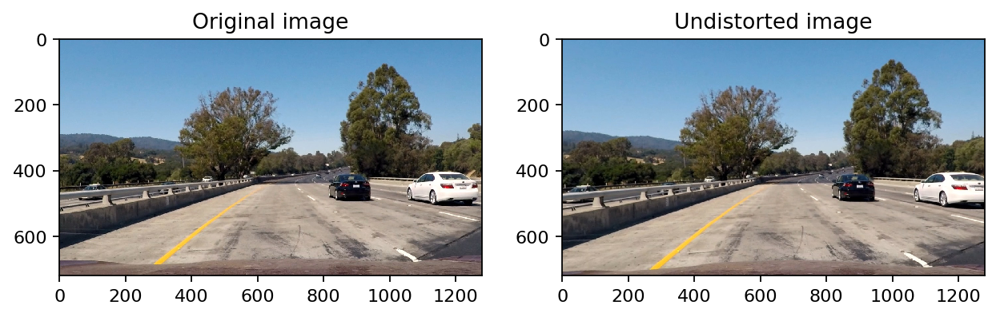

In [15]:
image = mpimg.imread('test_images/test1.jpg')
undistorted_image = camera.undistort(image)
plot_two_images(image, "Original image", undistorted_image, "Undistorted image")

Gradx


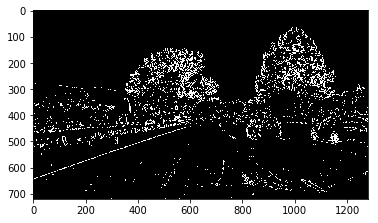

Grady


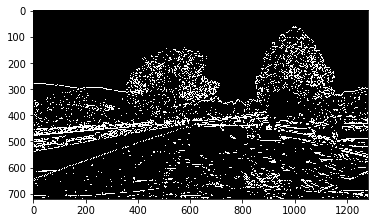

Magnitude


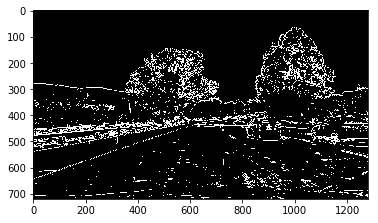

Directional


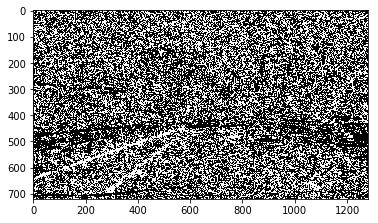

Combined


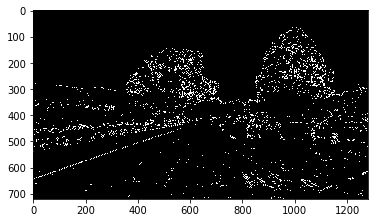

Color


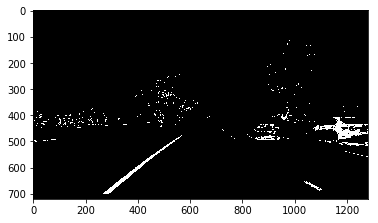

Stack


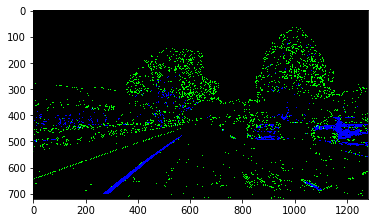

Combined


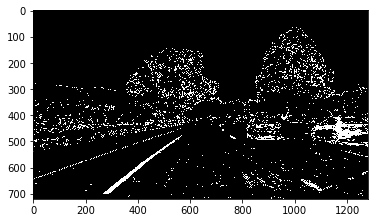

In [16]:
binary_image = thresholder.apply(undistorted_image, image_log=True)

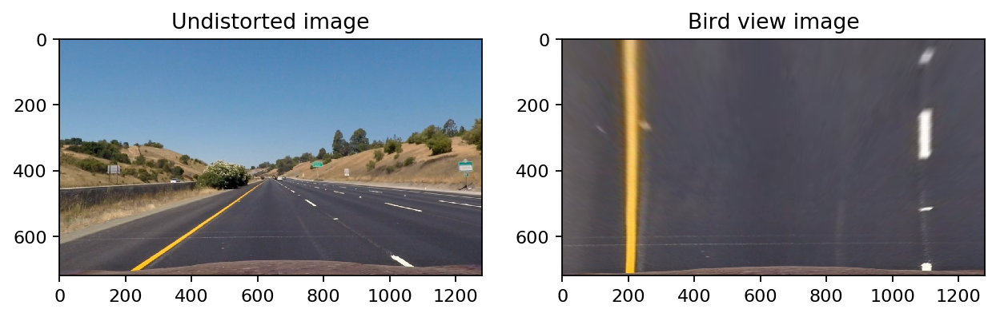

In [17]:
image = mpimg.imread('test_images/straight_lines1.jpg')
undistorted_image = camera.undistort(image)
bird_view_image, M = camera.bird_view(undistorted_image)
plot_two_images(undistorted_image, "Undistorted image", bird_view_image, "Bird view image")

In [21]:
# Define a class to receive the characteristics of each line detection
class Line(): 
    def __init__(self):     
        # polynomial coefficients
        self._fit = np.array([0,0,0], dtype='float')
        
        #difference in fit coefficients between last and new fits
        self.diffs = np.array([0,0,0], dtype='float')
        
        # y values for detected line pixels
        self.ploty = None
        
        # x values for detected line pixels
        self.fitx = None
        
        # was the line detected in the last iteration?
        self.detected = False  
        
        # x values of the last n fits of the line
        self.recent_fitx = []
        
        # number of recent fitx
        self.n_recent_fitx = 3     
        
        #polynomial coefficients averaged over the last n iterations
        self.best_fit = None
        
        #distance in meters of vehicle center from the line
        self.line_base_pos = None 
    
    # add current fitx to recent_fitx
    def add_fitx_to_recent(self):
        if len(self.recent_fitx) == self.n_recent_fitx:
            self.recent_fitx.pop(0)
        self.recent_fitx.append(self.fitx)
    
    # average x values of the fitted line over the last n iterations
    @property
    def best_fitx(self):
        recent_fitx_sum = np.sum(self.recent_fitx, axis=0)
        average_fitx = recent_fitx_sum/len(self.recent_fitx)
        return average_fitx
    
    # current fit getter
    @property
    def fit(self):
        return self._fit
    
    # current fit setter, calculates diffs
    @fit.setter
    def fit(self, value):
        self.diffs = value - self._fit
        self._fit = value    
    
    #radius of curvature of the line in meters
    @property
    def curverad(self):
        y_eval = np.max(self.ploty)
        curverad = ((1 + (2*self.fit[0]*y_eval + self.fit[1])**2)**1.5) / np.absolute(2*self.fit[0])
        
        # Define conversions in x and y from pixels space to meters
        ym_per_pix = 320/4500 # meters per pixel in y dimension
        xm_per_pix = 3.7/(1100-200) # meters per pixel in x dimension

        # Fit new polynomials to x,y in world space
        fit_cr = np.polyfit(self.ploty*ym_per_pix, self.fitx*xm_per_pix, 2)
        
        # Calculate the new radii of curvature
        curverad = ((1 + (2*fit_cr[0]*y_eval*ym_per_pix + fit_cr[1])**2)**1.5) / np.absolute(2*fit_cr[0])

        return curverad

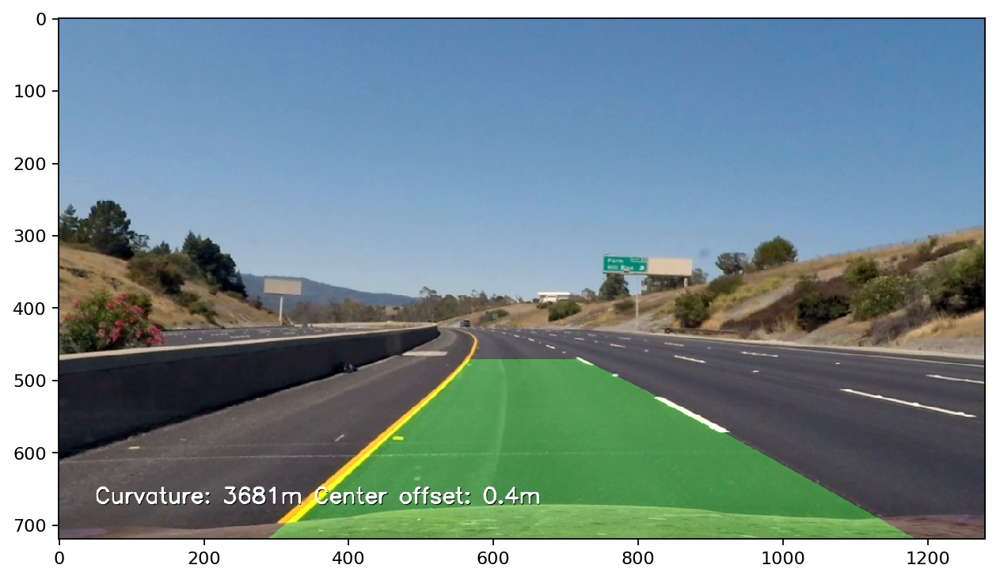

[MoviePy] >>>> Building video lane_finding_project_video.mp4
[MoviePy] Writing video lane_finding_project_video.mp4



  0%|          | 0/1261 [00:00<?, ?it/s]

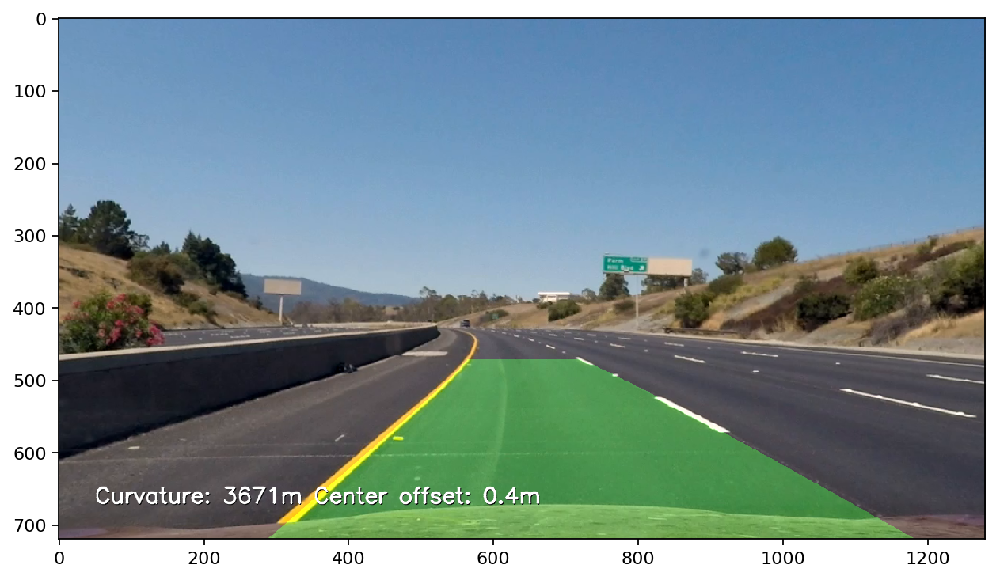


  0%|          | 1/1261 [00:02<45:14,  2.15s/it]Exception ignored in: <bound method VideoFileClip.__del__ of <moviepy.video.io.VideoFileClip.VideoFileClip object at 0x10e35c128>>
Traceback (most recent call last):
  File "/Users/moltenz/tensorflow/lib/python3.6/site-packages/moviepy/video/io/VideoFileClip.py", line 90, in __del__
    del self.reader
AttributeError: reader


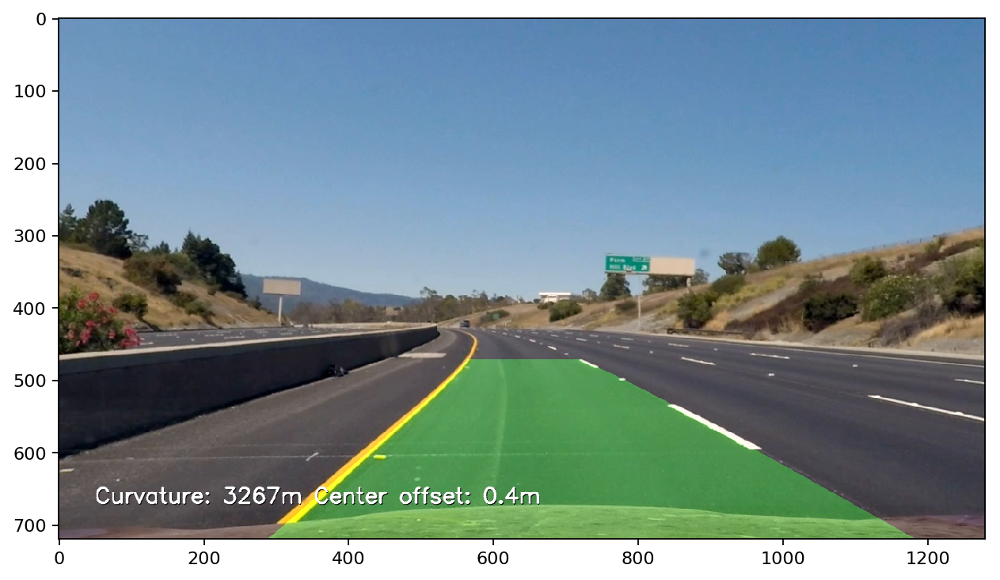


  0%|          | 2/1261 [00:04<45:54,  2.19s/it]

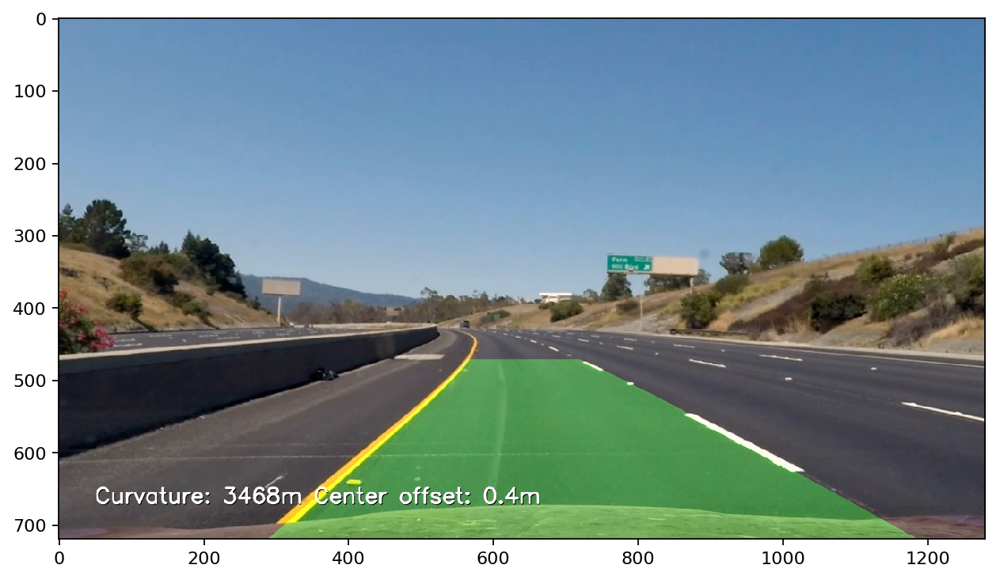


  0%|          | 3/1261 [00:06<44:43,  2.13s/it]

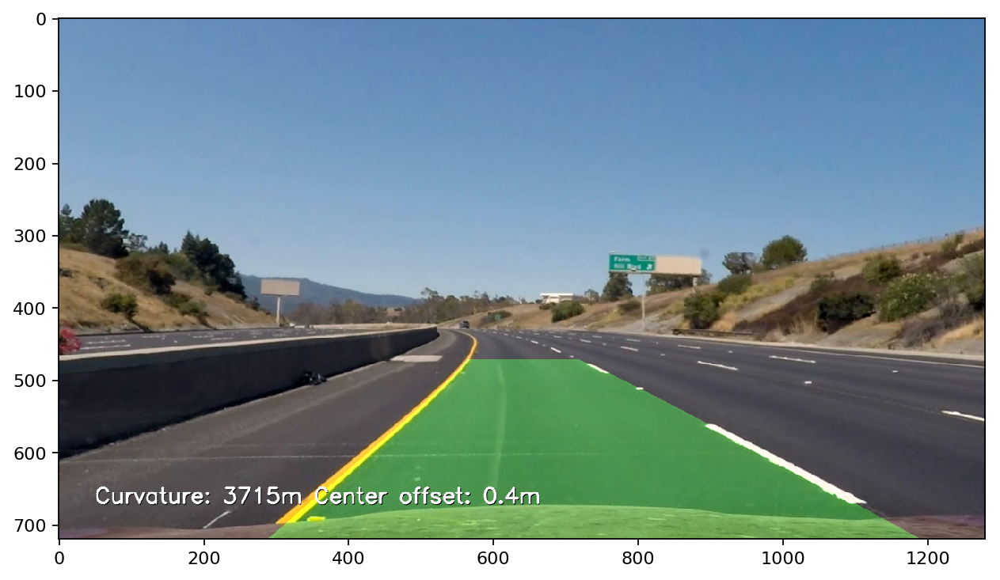


  0%|          | 4/1261 [00:08<42:53,  2.05s/it]

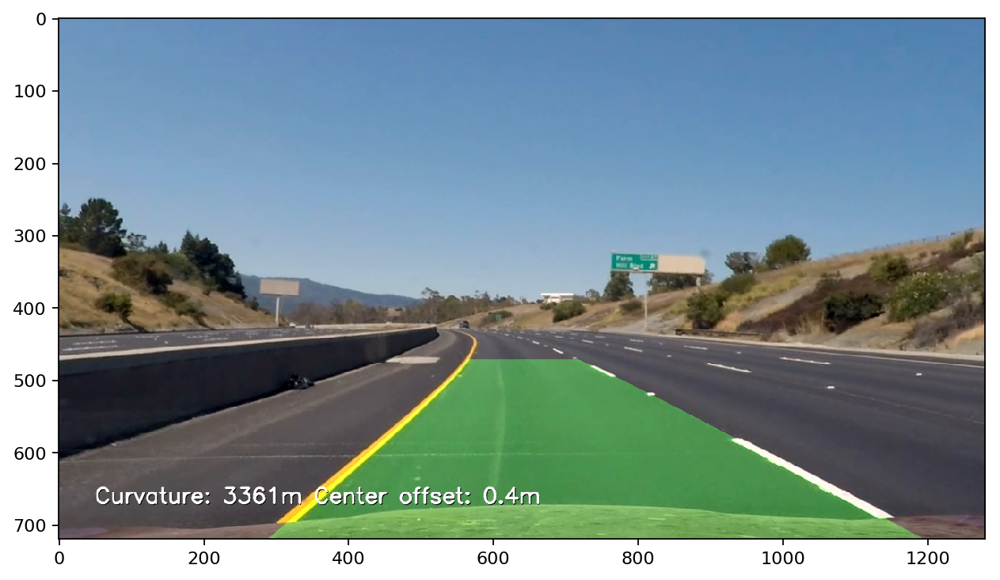


  0%|          | 5/1261 [00:10<41:16,  1.97s/it]

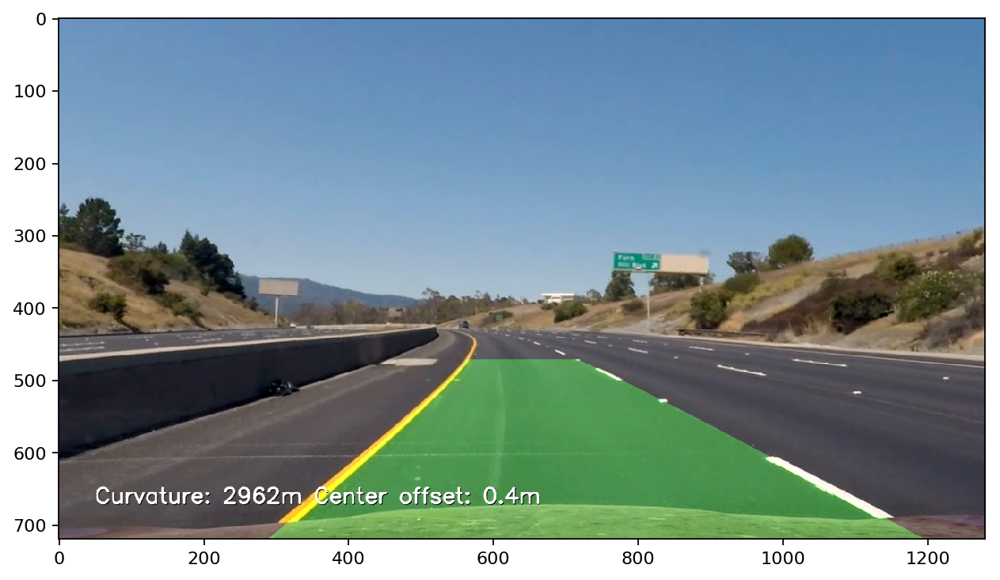


  0%|          | 6/1261 [00:11<40:04,  1.92s/it]

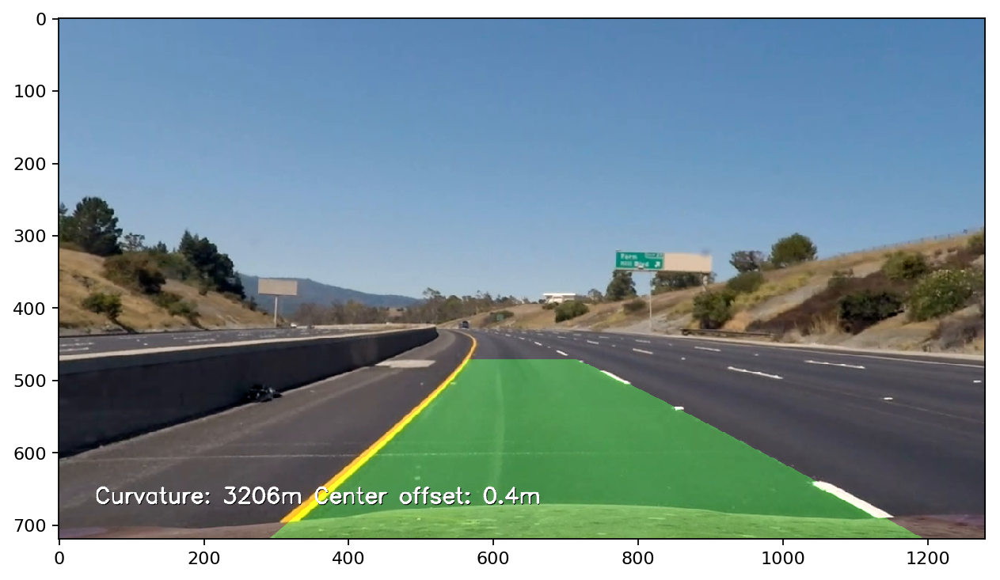


  1%|          | 7/1261 [00:13<39:33,  1.89s/it]

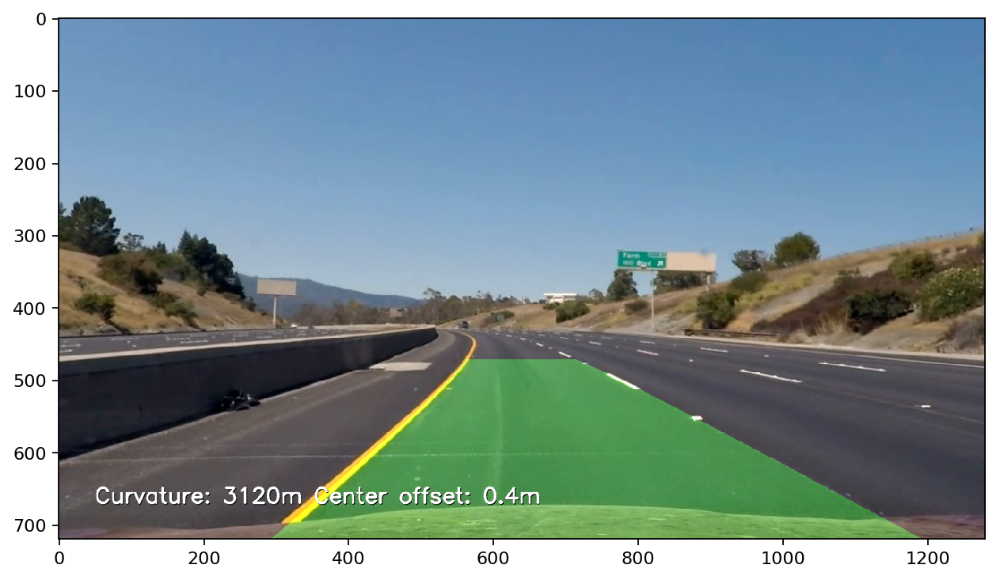


  1%|          | 8/1261 [00:15<39:12,  1.88s/it]

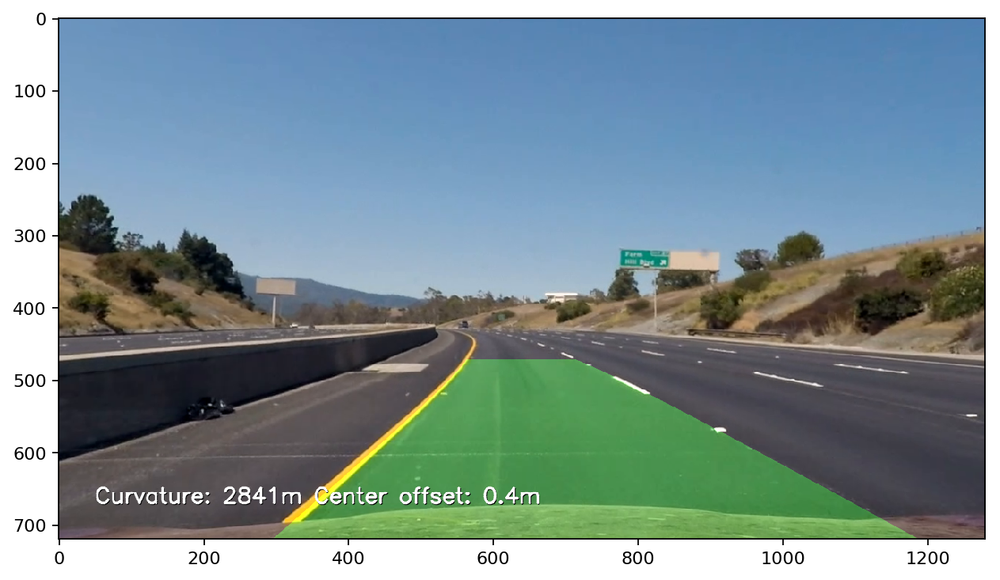


  1%|          | 9/1261 [00:17<38:53,  1.86s/it]

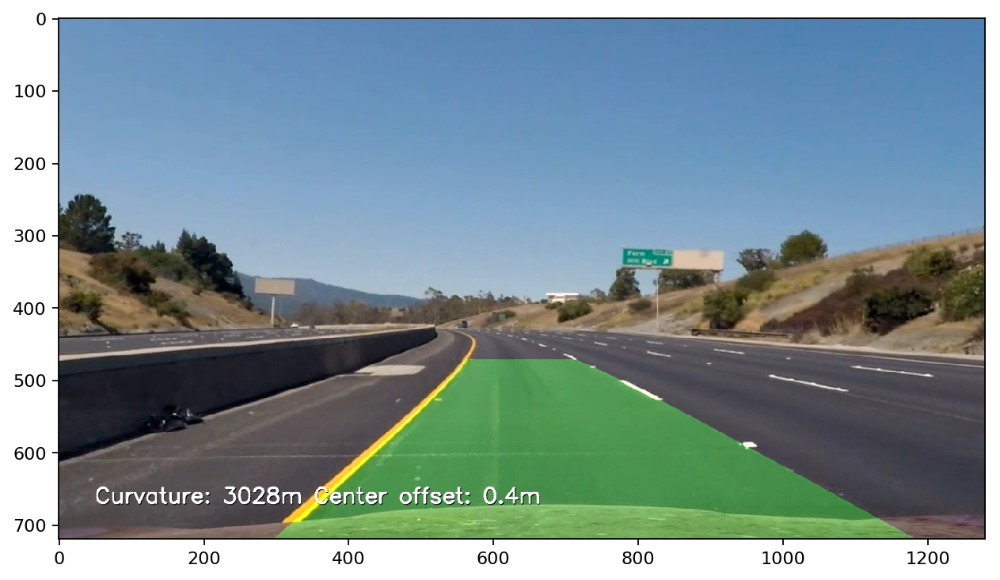


  1%|          | 10/1261 [00:19<39:36,  1.90s/it]

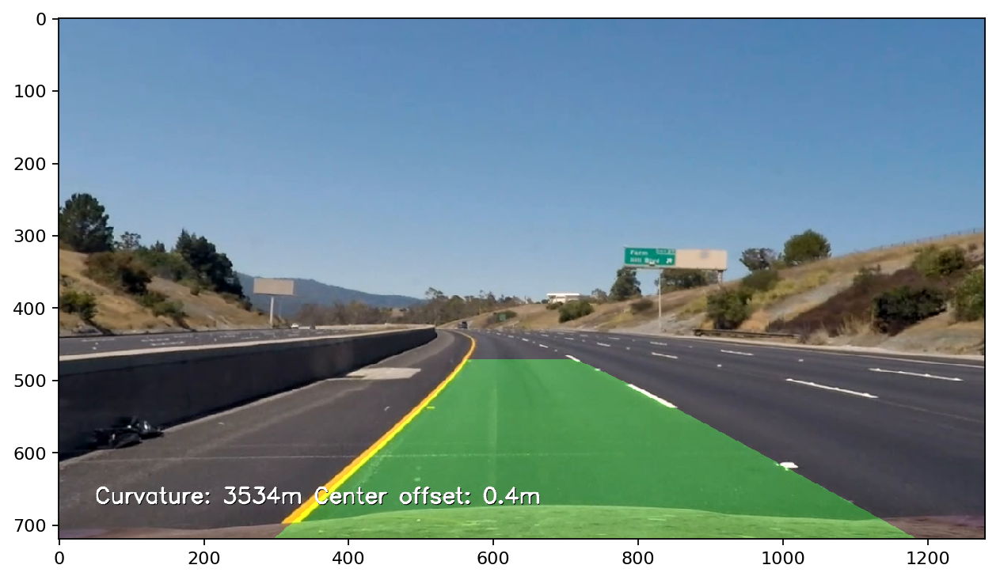


  1%|          | 11/1261 [00:21<39:43,  1.91s/it]

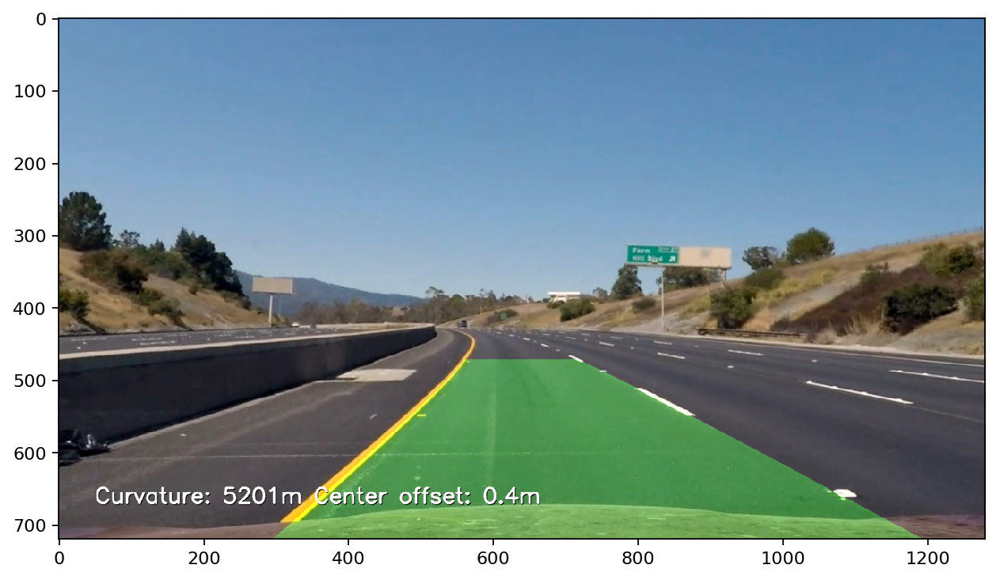


  1%|          | 12/1261 [00:23<39:06,  1.88s/it]

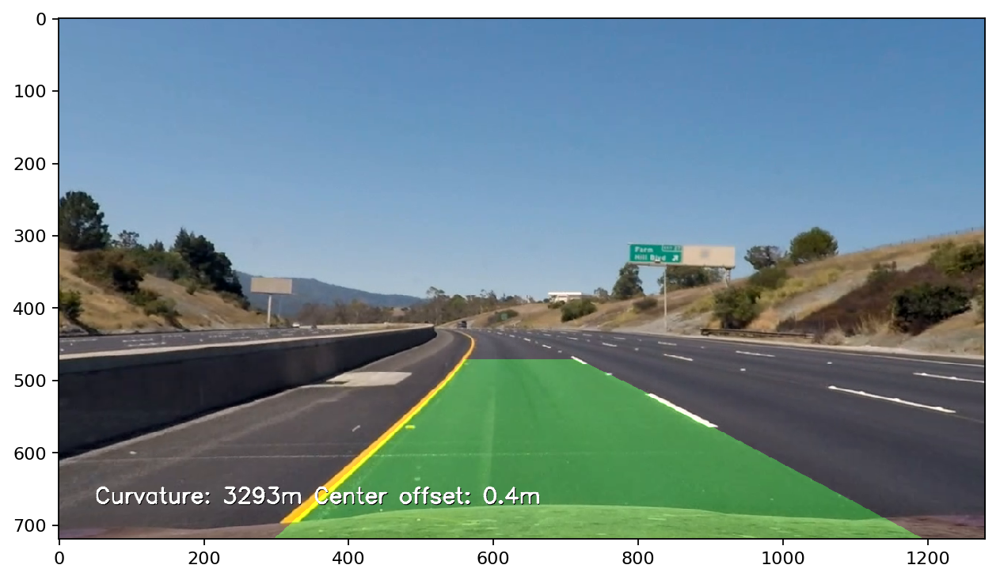


  1%|          | 13/1261 [00:24<39:13,  1.89s/it]

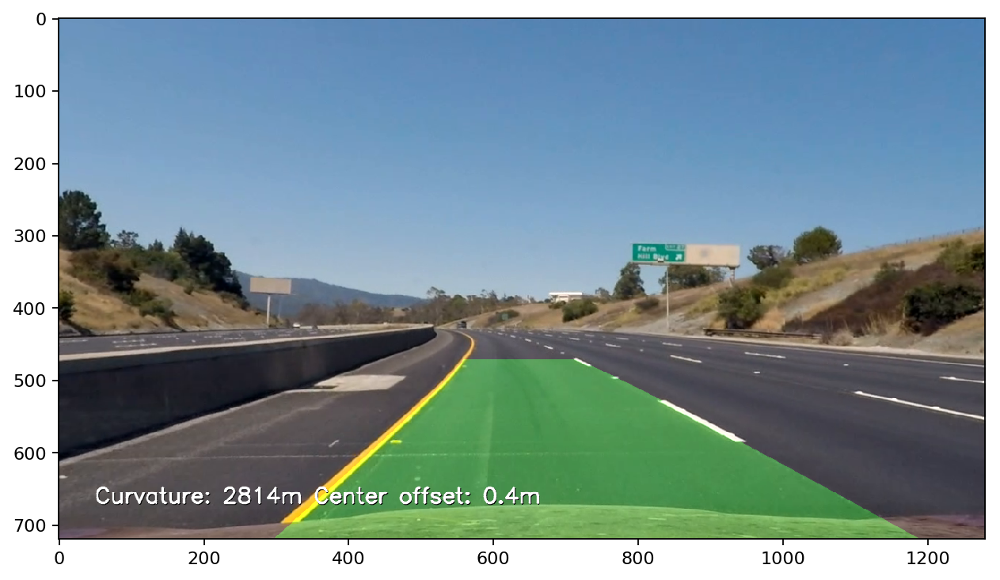


  1%|          | 14/1261 [00:26<38:42,  1.86s/it]

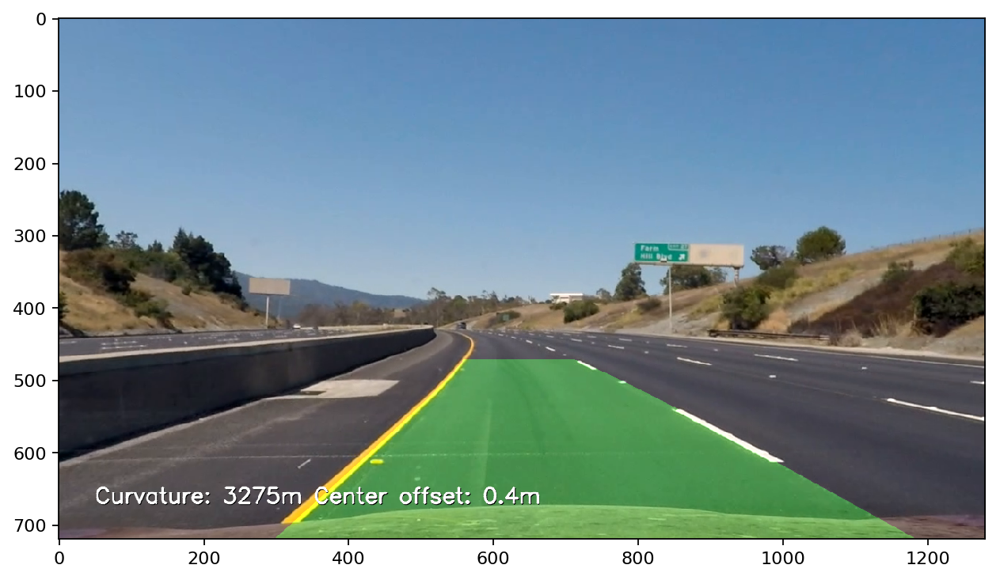


  1%|          | 15/1261 [00:28<38:41,  1.86s/it]

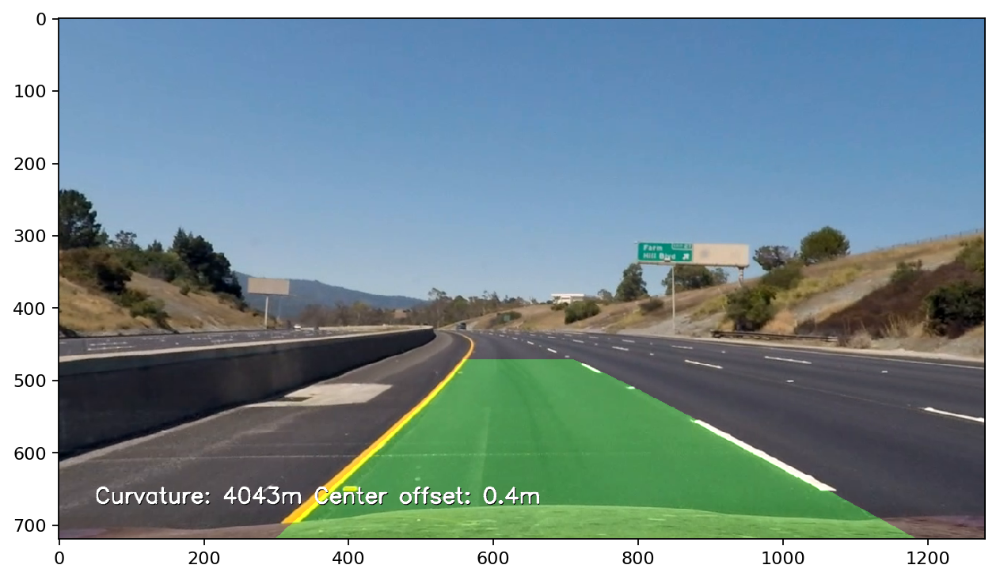


  1%|▏         | 16/1261 [00:30<39:10,  1.89s/it]

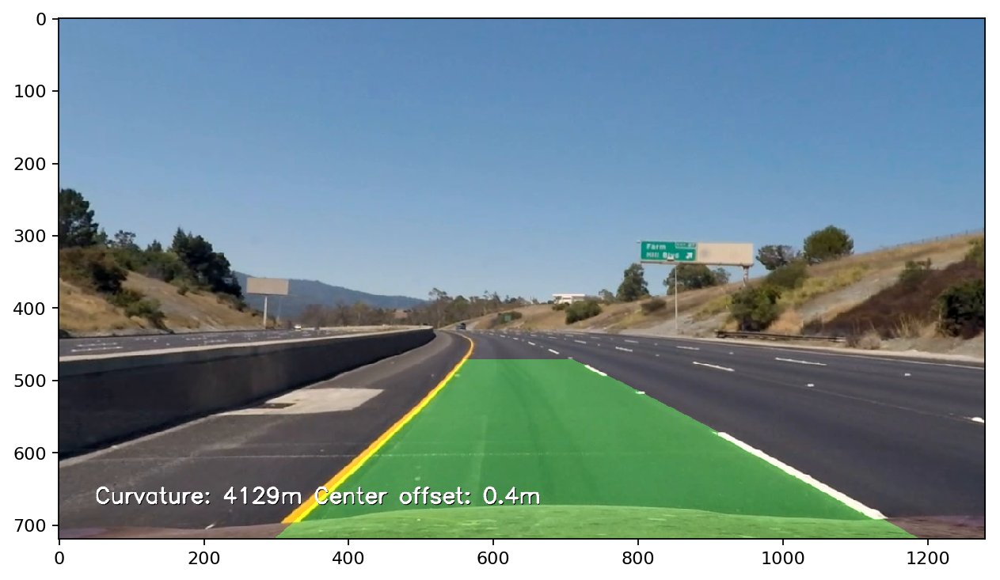


  1%|▏         | 17/1261 [00:32<38:40,  1.87s/it]

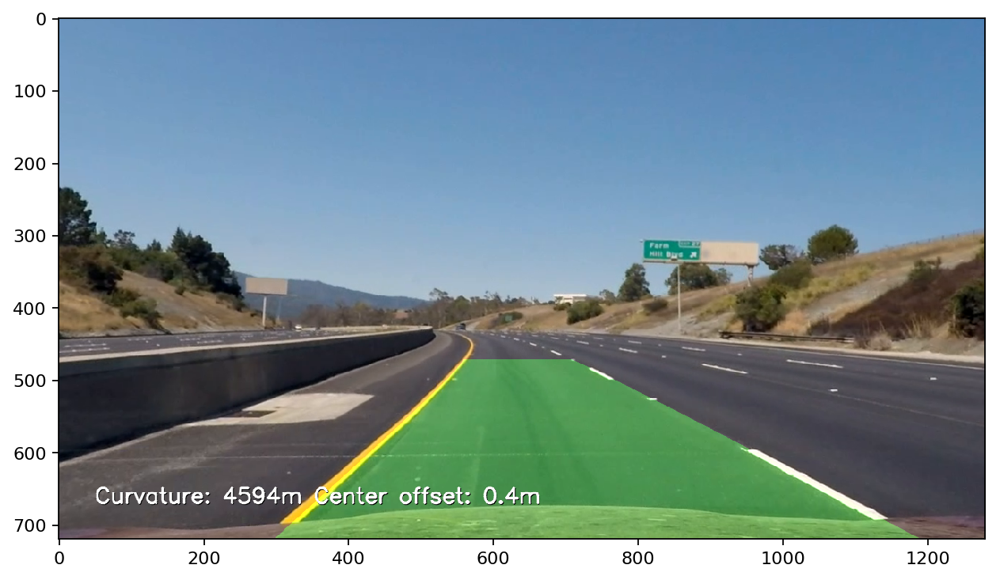


  1%|▏         | 18/1261 [00:34<38:01,  1.84s/it]

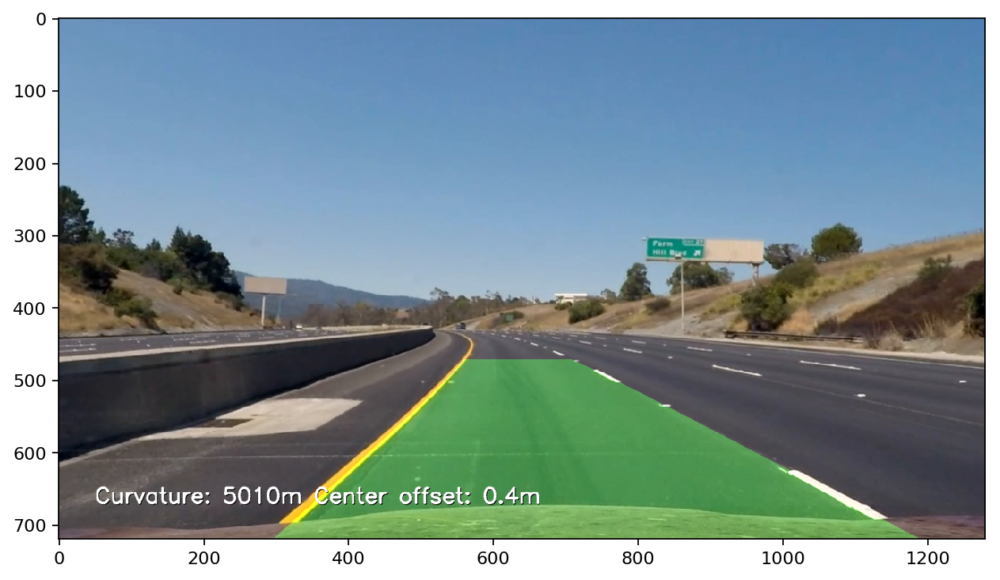


  2%|▏         | 19/1261 [00:36<38:58,  1.88s/it]

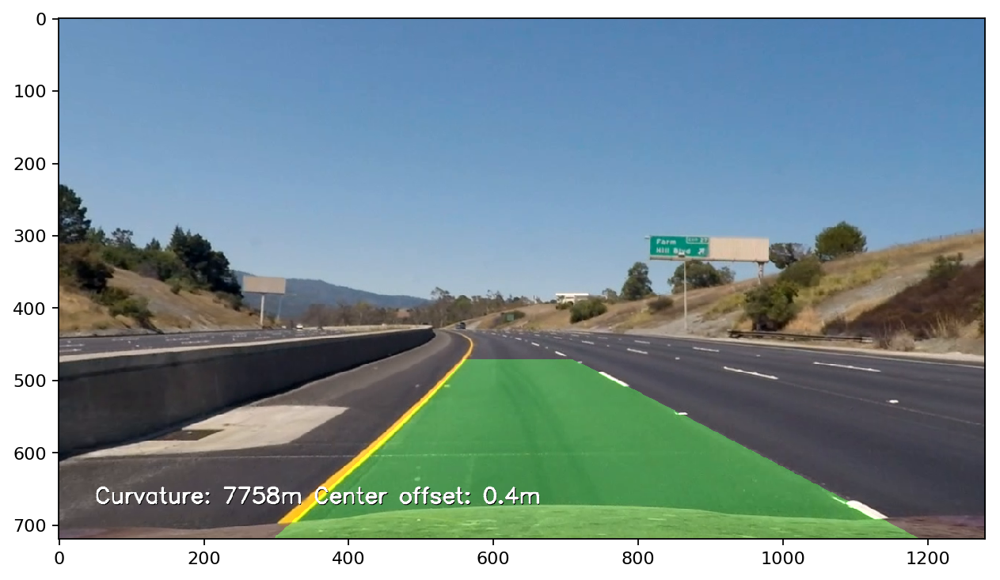


  2%|▏         | 20/1261 [00:37<38:33,  1.86s/it]

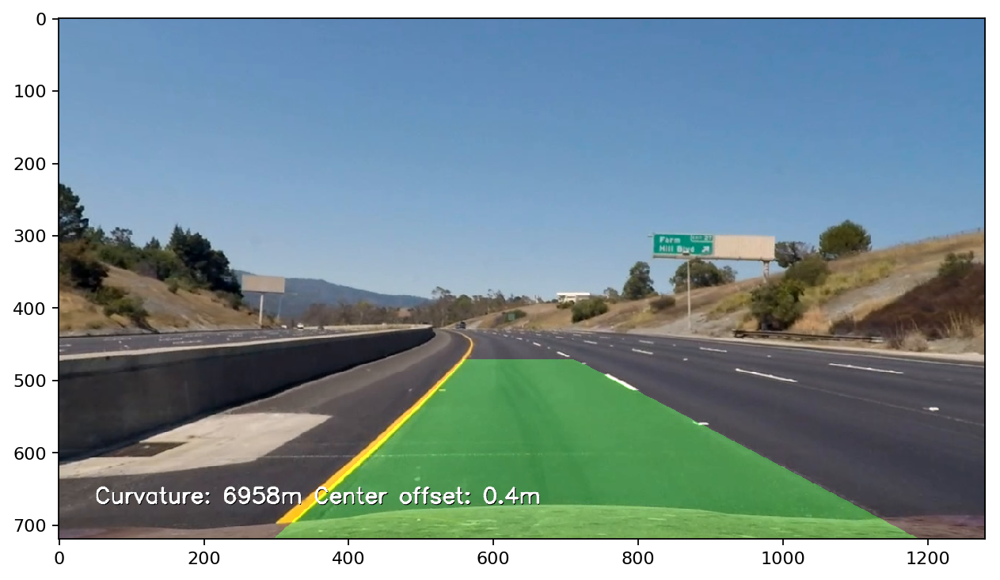


  2%|▏         | 21/1261 [00:40<39:22,  1.91s/it]

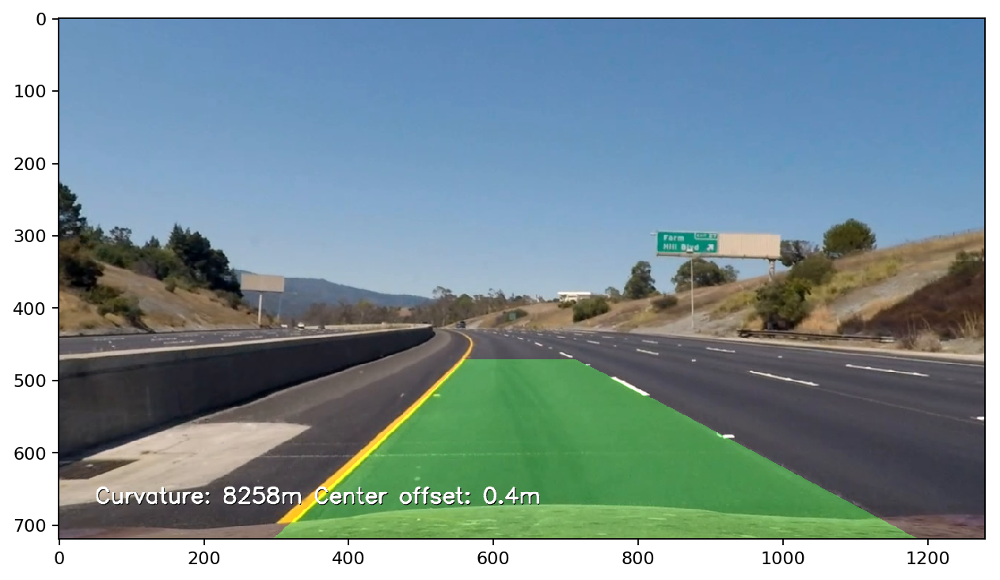


  2%|▏         | 22/1261 [00:41<38:50,  1.88s/it]

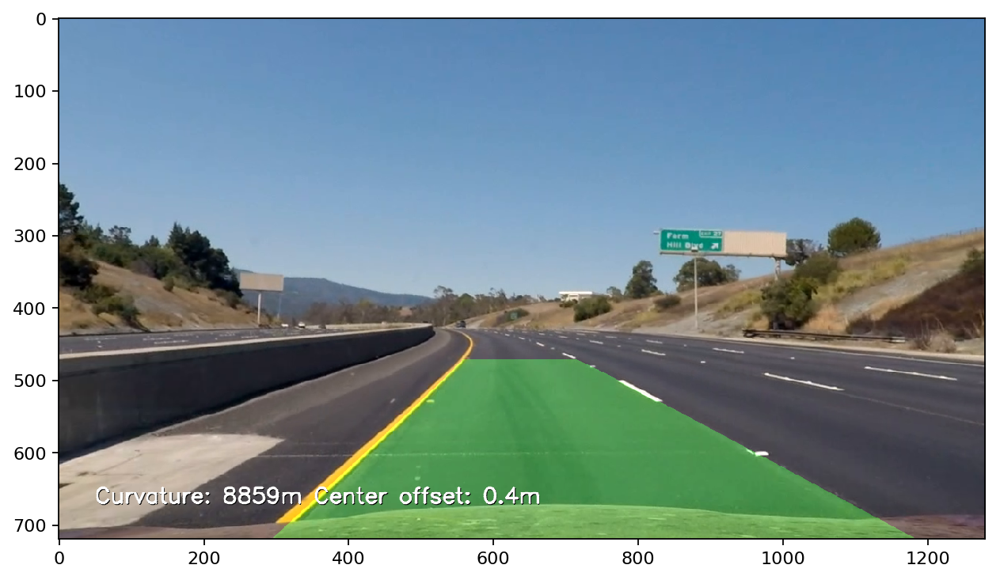


  2%|▏         | 23/1261 [00:43<38:20,  1.86s/it]

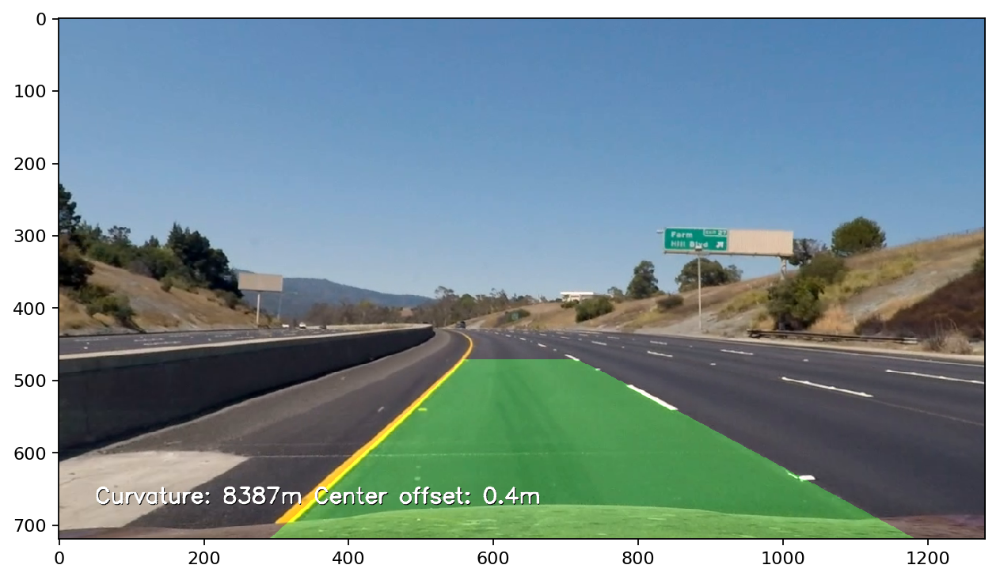


  2%|▏         | 24/1261 [00:45<38:51,  1.88s/it]

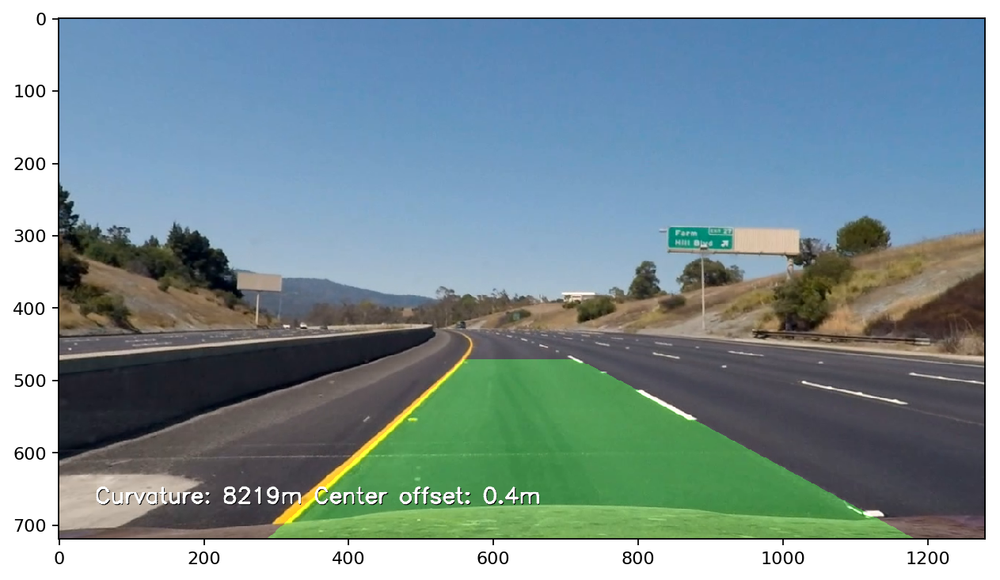


  2%|▏         | 25/1261 [00:47<39:19,  1.91s/it]

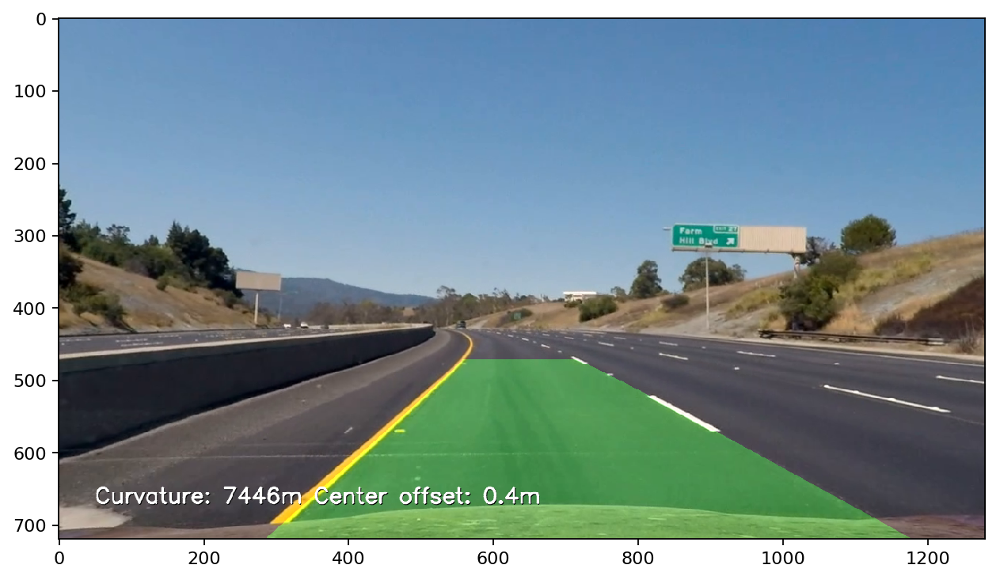


  2%|▏         | 26/1261 [00:49<39:25,  1.92s/it]

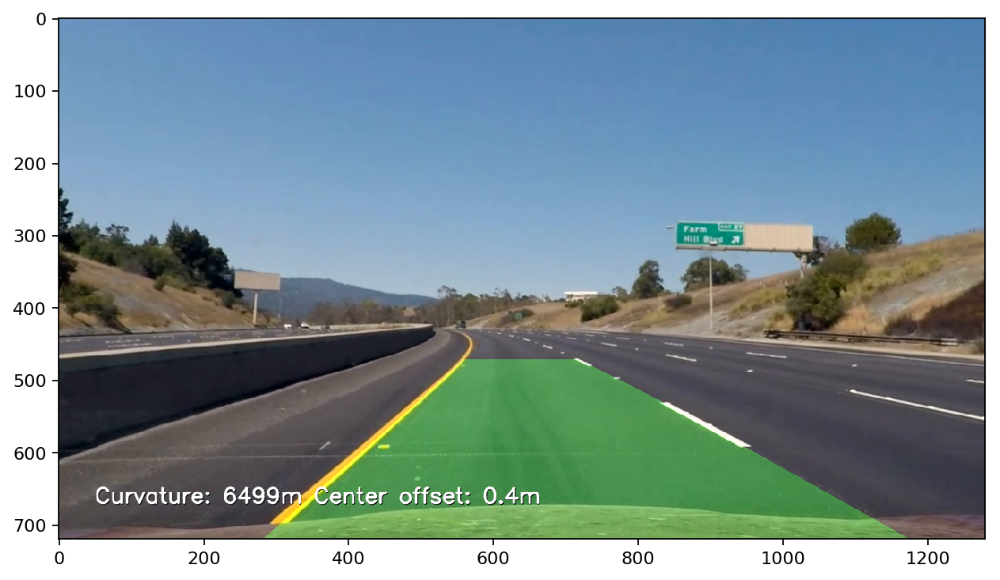


  2%|▏         | 27/1261 [00:51<39:11,  1.91s/it]

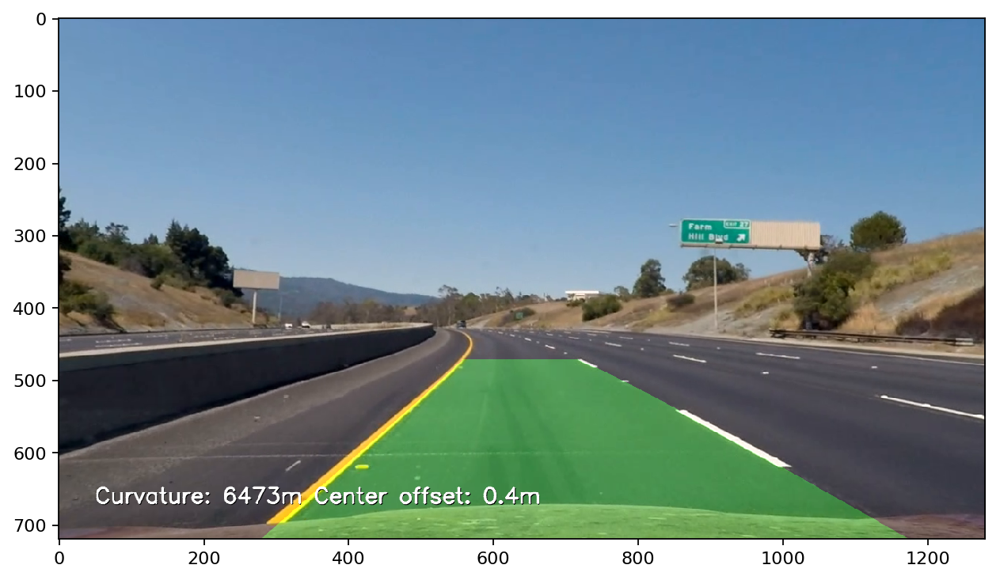


  2%|▏         | 28/1261 [00:53<39:07,  1.90s/it]

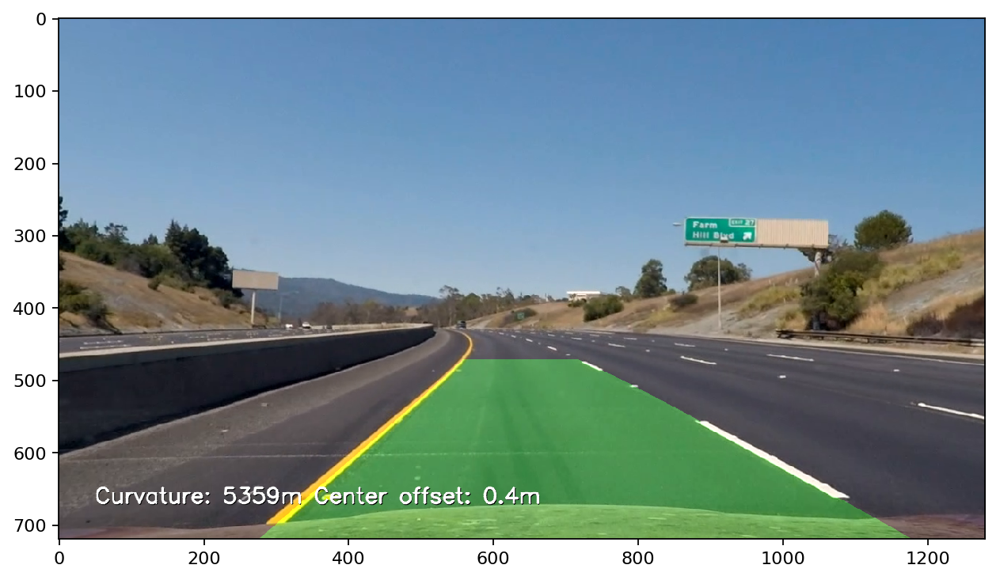


  2%|▏         | 29/1261 [00:55<39:15,  1.91s/it]

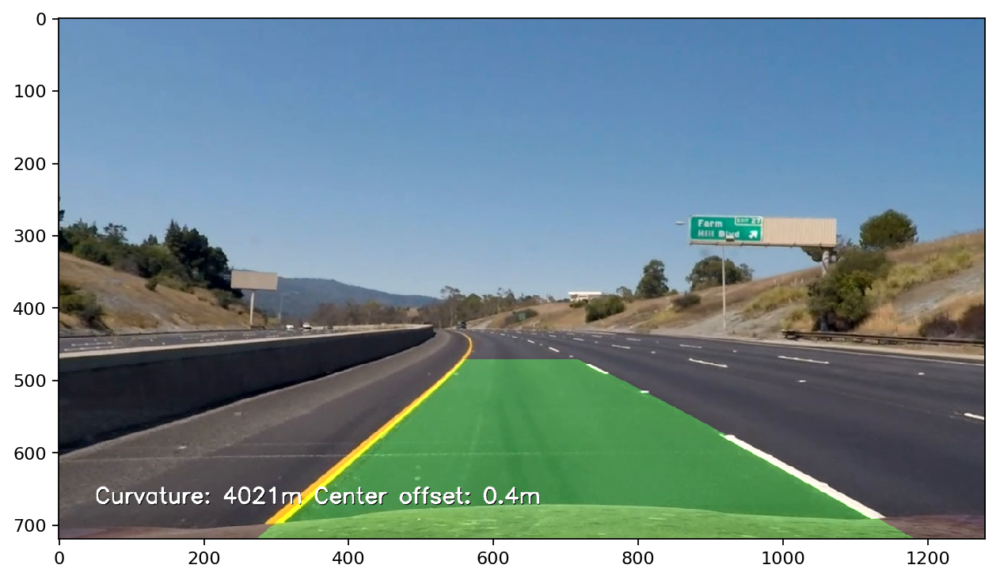


  2%|▏         | 30/1261 [00:57<39:36,  1.93s/it]

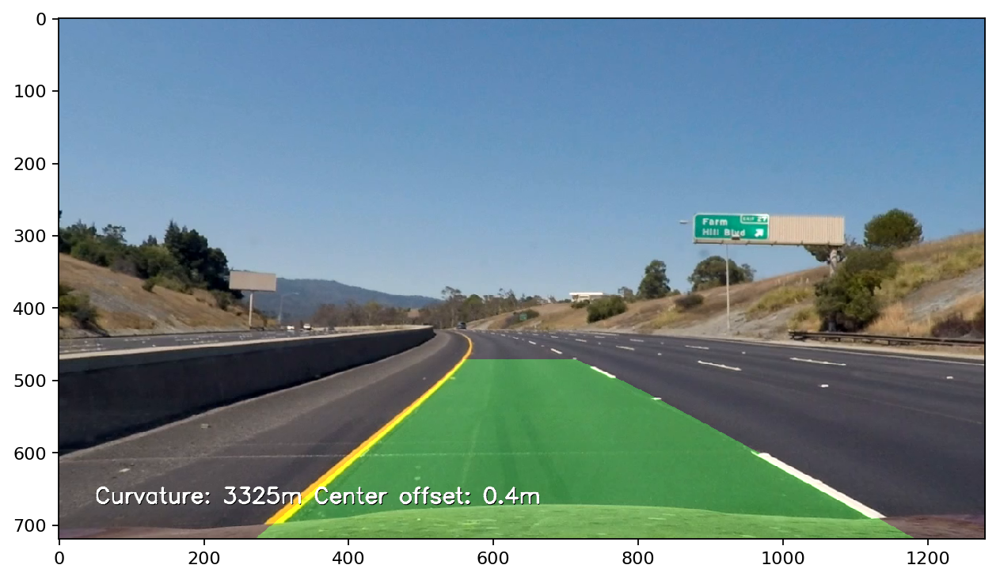


  2%|▏         | 31/1261 [00:59<40:56,  2.00s/it]

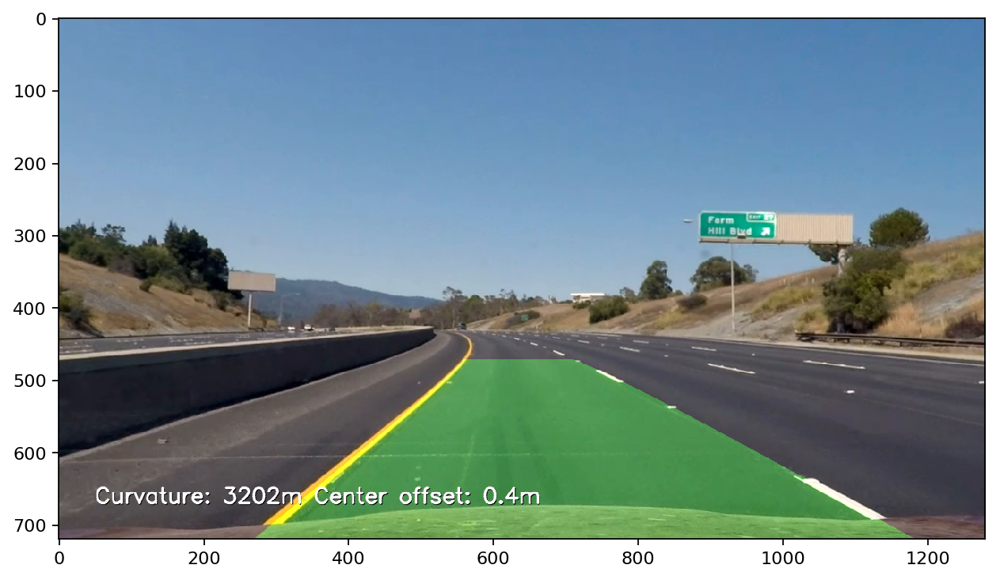


  3%|▎         | 32/1261 [01:01<40:23,  1.97s/it]

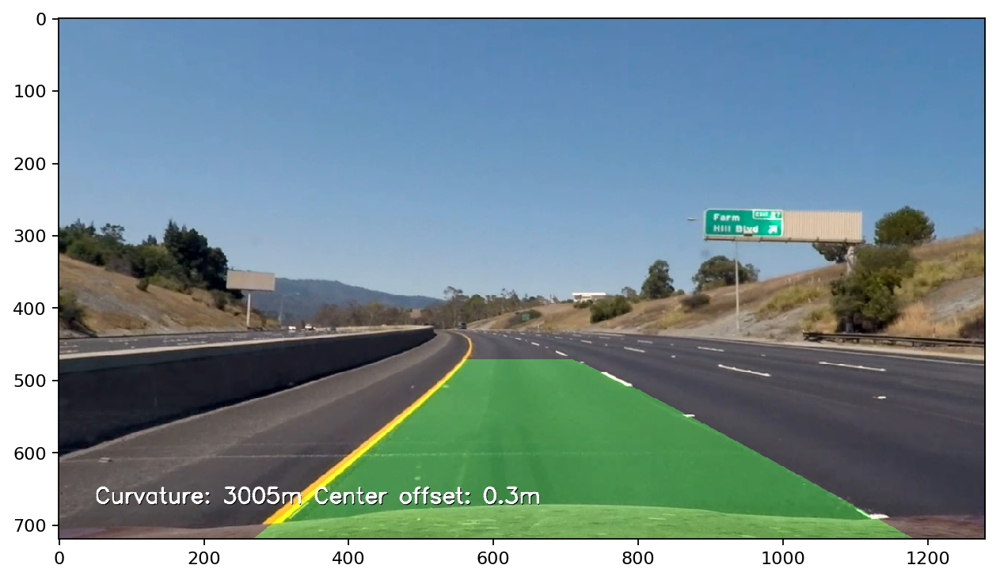


  3%|▎         | 33/1261 [01:03<39:35,  1.93s/it]

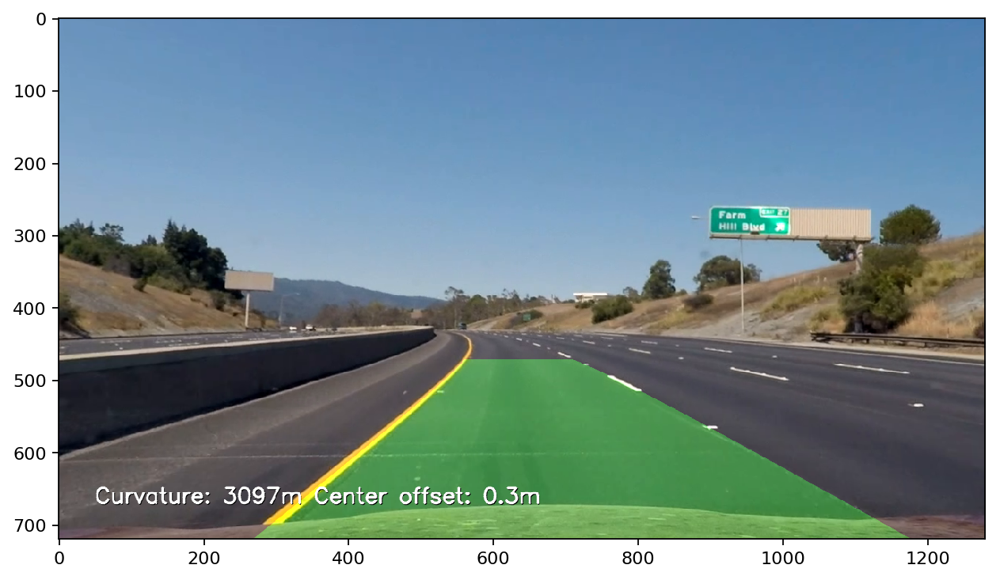


  3%|▎         | 34/1261 [01:04<39:02,  1.91s/it]

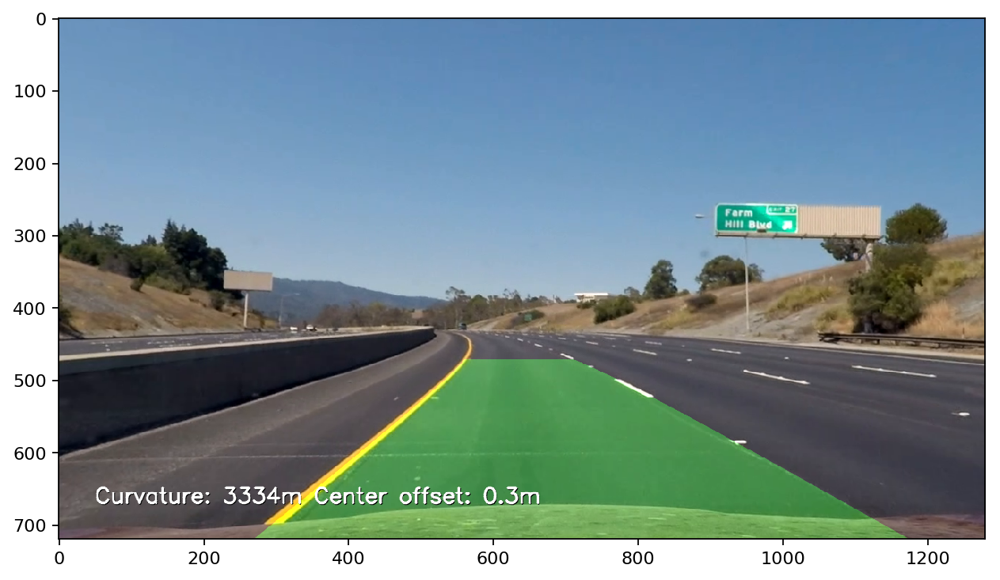


  3%|▎         | 35/1261 [01:06<38:53,  1.90s/it]

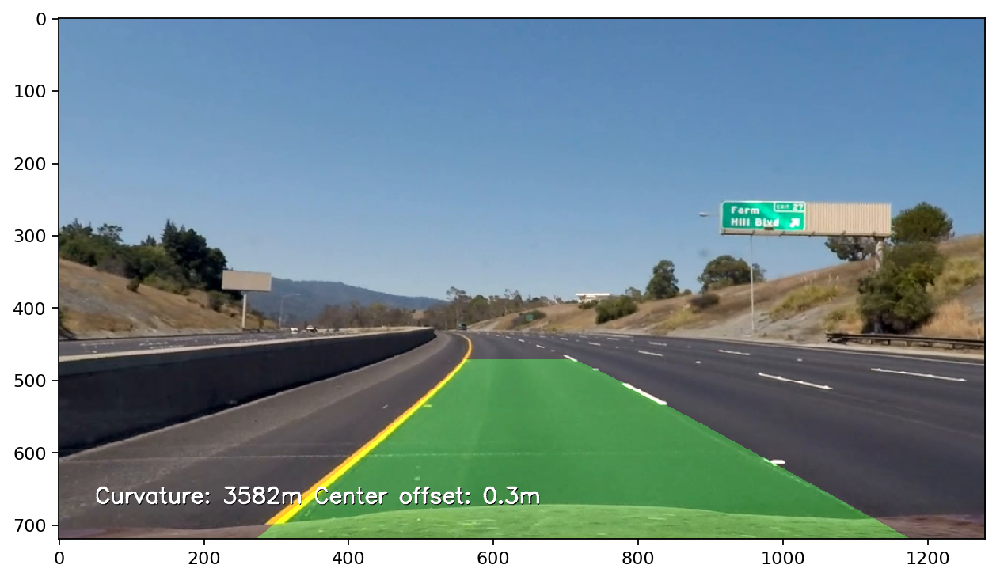


  3%|▎         | 36/1261 [01:08<38:35,  1.89s/it]

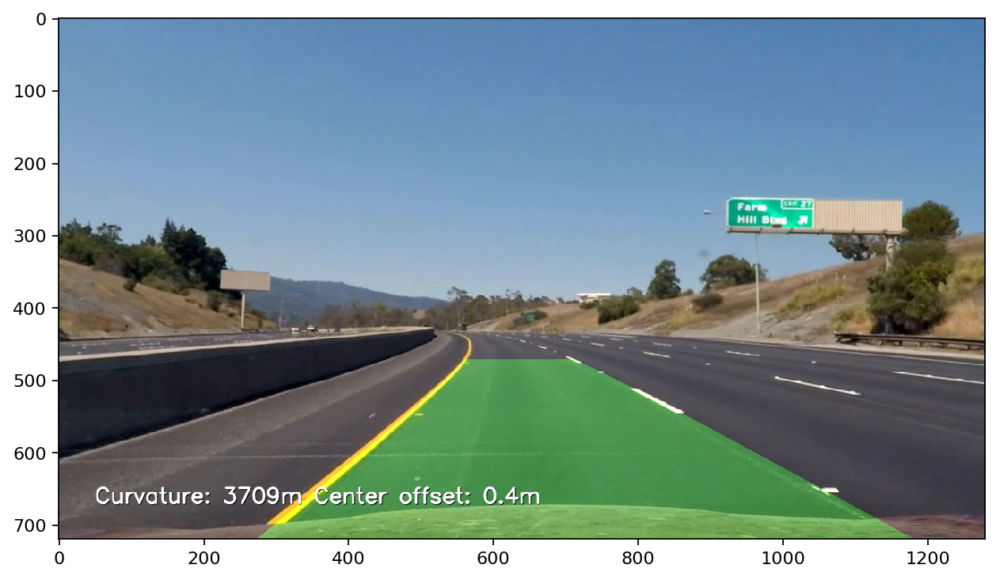


  3%|▎         | 37/1261 [01:10<38:37,  1.89s/it]

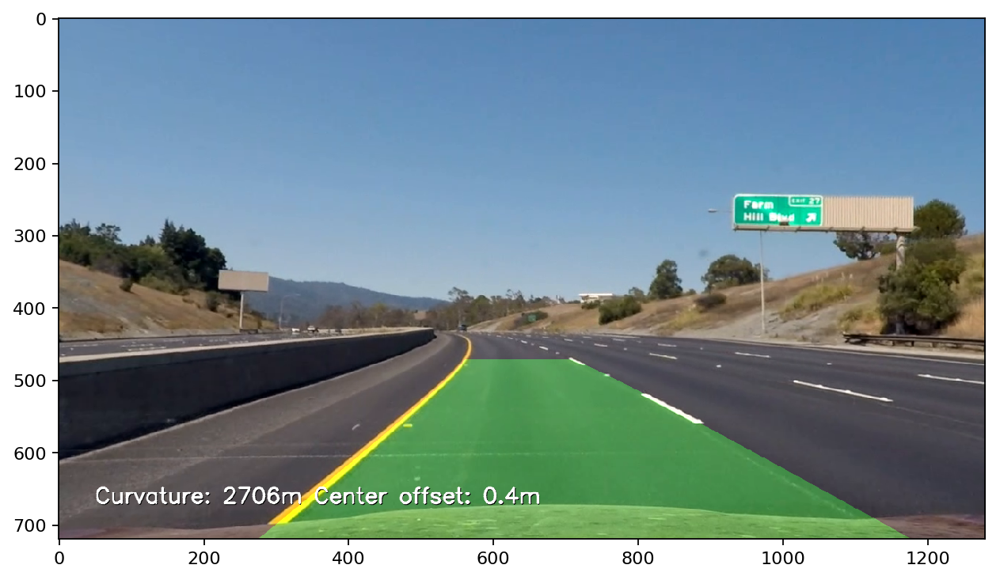


  3%|▎         | 38/1261 [01:12<38:51,  1.91s/it]

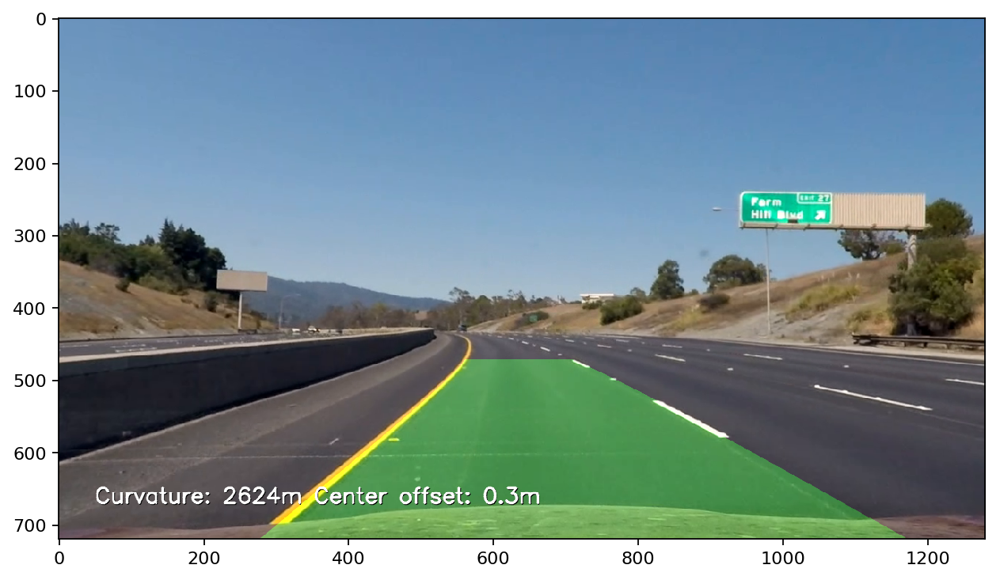


  3%|▎         | 39/1261 [01:14<38:48,  1.91s/it]

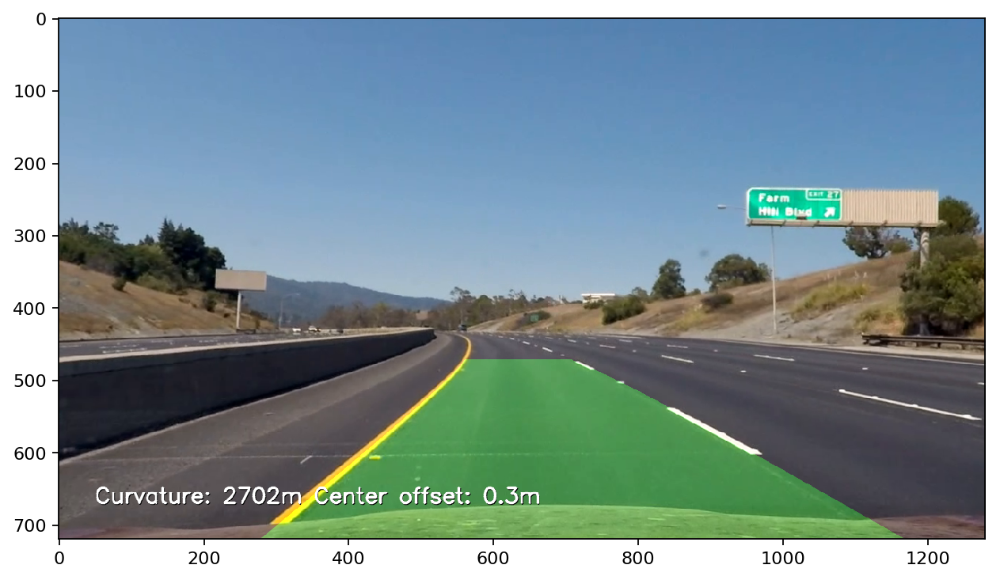


  3%|▎         | 40/1261 [01:16<38:31,  1.89s/it]

In [ ]:
class LaneAgent():
    def __init__(self):
        self.left_line = Line()
        self.right_line = Line()
        self.max_difficult_frames = 6
        self.difficult_frame = 0
        self.first_time = True
        
    def process_frame(self, image):
        undistorted_image = camera.undistort(image)
        bird_view_image, M = camera.bird_view(undistorted_image)
        binary_warped = thresholder.apply(bird_view_image, image_log=False)            
        
        if not self.left_line.detected or not self.left_line.detected:
            if self.first_time or self.difficult_frame == self.max_difficult_frames:
                self.difficult_frame = 0
                self.left_line.fit, self.right_line.fit = self._search_lines(binary_warped)
                self.left_line.detected = True
                self.right_line.detected = True
                self.first_time = False
                
                self.left_line.fit, self.right_line.fit, self.left_line.ploty, self.left_line.fitx, self.right_line.fitx = self._search_lines_with_previous_detection(binary_warped, self.left_line.fit, self.right_line.fit)
                self.right_line.ploty = self.left_line.ploty
            else:
                self.difficult_frame += 1
        else:
            self.left_line.fit, self.right_line.fit, self.left_line.ploty, self.left_line.fitx, self.right_line.fitx = self._search_lines_with_previous_detection(binary_warped, self.left_line.fit, self.right_line.fit)
            self.right_line.ploty = self.left_line.ploty
        
        if not self.sanity_check():
            self.left_line.detected = False
            self.right_line.detected = False
        else:
            self.left_line.add_fitx_to_recent()
            self.right_line.add_fitx_to_recent()
        
        result = self.overlap(binary_warped, self.left_line.ploty, self.left_line.best_fitx, self.right_line.best_fitx, M, undistorted_image, image)
        
        # Add curvature and center offset to image
        lane_curverad = int((self.left_line.curverad + self.right_line.curverad)/2)
        car_center_offset = self.center_offset(result, self.left_line.best_fitx, self.right_line.best_fitx)
        
        text = 'Curvature: {0:.0f}m Center offset: {1:.1f}m'.format(lane_curverad, car_center_offset)
        cv2.putText(result, text, (50 + 1, result.shape[0] - 50 + 1), cv2.FONT_HERSHEY_SIMPLEX, 1, (0, 0, 0), 2, cv2.LINE_AA)
        cv2.putText(result, text, (50, result.shape[0] - 50), cv2.FONT_HERSHEY_SIMPLEX, 1, (255, 255, 255), 2, cv2.LINE_AA)
    
        plot_one_image(result, '')
        
        return result
    
    def sanity_check(self):
        # similar curvature
        if self.left_line.curverad/self.right_line.curverad > 15.0:
            return False
        
        if self.left_line.curverad/self.right_line.curverad < 1.0/15.0:
            return False
        
        # separated by approximately the right distance horizontally
        # roughly parallel
        ploty = self.left_line.ploty
        left_fitx = self.left_line.fit[0]*ploty**2 + self.left_line.fit[1]*ploty + self.left_line.fit[2]
        right_fitx = self.right_line.fit[0]*ploty**2 + self.right_line.fit[1]*ploty + self.right_line.fit[2]
        diff_fitx = right_fitx - left_fitx
        if np.max(diff_fitx) - np.min(diff_fitx) > 100:
            return False
                
        return True
    
    def center_offset(self, image, left_fitx, right_fitx):
        # Define conversions in x and y from pixels space to meters
        ym_per_pix = 320/4500 # meters per pixel in y dimension
        xm_per_pix = 3.7/(1100-200) # meters per pixel in x dimension
        
        left_lastx = left_fitx[len(left_fitx) - 1]
        right_lastx = right_fitx[len(right_fitx) - 1]
        lane_center_offset = int((left_lastx + right_lastx) / 2)*xm_per_pix
        image_center_offet = image.shape[1]*xm_per_pix/2
        center_offset = lane_center_offset-image_center_offet
        
        return center_offset
    
    def _search_lines(self, binary_warped):
        lx, rx = agent.histogram_peaks(binary_warped, y_from=int(image.shape[0]/2), y_to=int(image.shape[0]))
        out_img = np.dstack((binary_warped, binary_warped, binary_warped))

        # Choose the number of sliding windows
        nwindows = 9
        # Set height of windows
        window_height = np.int(binary_warped.shape[0]/nwindows)
        # Identify the x and y positions of all nonzero pixels in the image
        nonzero = binary_warped.nonzero()
        nonzeroy = np.array(nonzero[0])
        nonzerox = np.array(nonzero[1])
        # Current positions to be updated for each window
        leftx_current = lx
        rightx_current = rx
        # Set the width of the windows +/- margin
        margin = 100
        # Set minimum number of pixels found to recenter window
        minpix = 50
        # Create empty lists to receive left and right lane pixel indices
        left_lane_inds = []
        right_lane_inds = []

        # Step through the windows one by one
        for window in range(nwindows):
            # Identify window boundaries in x and y (and right and left)
            win_y_low = binary_warped.shape[0] - (window+1)*window_height
            win_y_high = binary_warped.shape[0] - window*window_height
            win_xleft_low = leftx_current - margin
            win_xleft_high = leftx_current + margin
            win_xright_low = rightx_current - margin
            win_xright_high = rightx_current + margin
            # Draw the windows on the visualization image
            cv2.rectangle(out_img,(win_xleft_low,win_y_low),(win_xleft_high,win_y_high),(0,255,0), 2) 
            cv2.rectangle(out_img,(win_xright_low,win_y_low),(win_xright_high,win_y_high),(0,255,0), 2) 
            # Identify the nonzero pixels in x and y within the window
            good_left_inds = ((nonzeroy >= win_y_low) & (nonzeroy < win_y_high) & (nonzerox >= win_xleft_low) & (nonzerox < win_xleft_high)).nonzero()[0]
            good_right_inds = ((nonzeroy >= win_y_low) & (nonzeroy < win_y_high) & (nonzerox >= win_xright_low) & (nonzerox < win_xright_high)).nonzero()[0]
            # Append these indices to the lists
            left_lane_inds.append(good_left_inds)
            right_lane_inds.append(good_right_inds)
            # If you found > minpix pixels, recenter next window on their mean position
            if len(good_left_inds) > minpix:
                leftx_current = np.int(np.mean(nonzerox[good_left_inds]))
            if len(good_right_inds) > minpix:        
                rightx_current = np.int(np.mean(nonzerox[good_right_inds]))

        # Concatenate the arrays of indices
        left_lane_inds = np.concatenate(left_lane_inds)
        right_lane_inds = np.concatenate(right_lane_inds)

        # Extract left and right line pixel positions
        leftx = nonzerox[left_lane_inds]
        lefty = nonzeroy[left_lane_inds] 
        rightx = nonzerox[right_lane_inds]
        righty = nonzeroy[right_lane_inds] 

        # Fit a second order polynomial to each
        left_fit = np.polyfit(lefty, leftx, 2)
        right_fit = np.polyfit(righty, rightx, 2)


        # Generate x and y values for plotting
        ploty = np.linspace(0, binary_warped.shape[0]-1, binary_warped.shape[0] )
        left_fitx = left_fit[0]*ploty**2 + left_fit[1]*ploty + left_fit[2]
        right_fitx = right_fit[0]*ploty**2 + right_fit[1]*ploty + right_fit[2]

#         out_img[nonzeroy[left_lane_inds], nonzerox[left_lane_inds]] = [255, 0, 0]
#         out_img[nonzeroy[right_lane_inds], nonzerox[right_lane_inds]] = [0, 0, 255]
#         plt.title('Thresholded view and Polynomials')
#         plt.imshow(cv2.cvtColor(binary_image.astype(np.float32), cv2.COLOR_GRAY2RGB))
#         plt.plot(left_fitx, ploty, color='yellow')
#         plt.plot(right_fitx, ploty, color='yellow')
#         plt.xlim(0, 1280)
#         plt.ylim(720, 0)
#         plt.show()
        
        return left_fit, right_fit
        
    def _search_lines_with_previous_detection(self, binary_warped, left_fit, right_fit):        
        # Assume you now have a new warped binary image 
        # from the next frame of video (also called "binary_warped")
        # It's now much easier to find line pixels!
        nonzero = binary_warped.nonzero()
        nonzeroy = np.array(nonzero[0])
        nonzerox = np.array(nonzero[1])
        margin = 100
        left_lane_inds = ((nonzerox > (left_fit[0]*(nonzeroy**2) + left_fit[1]*nonzeroy + left_fit[2] - margin)) & (nonzerox < (left_fit[0]*(nonzeroy**2) + left_fit[1]*nonzeroy + left_fit[2] + margin))) 
        right_lane_inds = ((nonzerox > (right_fit[0]*(nonzeroy**2) + right_fit[1]*nonzeroy + right_fit[2] - margin)) & (nonzerox < (right_fit[0]*(nonzeroy**2) + right_fit[1]*nonzeroy + right_fit[2] + margin)))  

        # Again, extract left and right line pixel positions
        leftx = nonzerox[left_lane_inds]
        lefty = nonzeroy[left_lane_inds] 
        rightx = nonzerox[right_lane_inds]
        righty = nonzeroy[right_lane_inds]
        # Fit a second order polynomial to each
        left_fit = np.polyfit(lefty, leftx, 2)
        right_fit = np.polyfit(righty, rightx, 2)
        # Generate x and y values for plotting
        ploty = np.linspace(0, binary_warped.shape[0]-1, binary_warped.shape[0] )
        left_fitx = left_fit[0]*ploty**2 + left_fit[1]*ploty + left_fit[2]
        right_fitx = right_fit[0]*ploty**2 + right_fit[1]*ploty + right_fit[2]

        # Create an image to draw on and an image to show the selection window
        out_img = np.dstack((binary_warped, binary_warped, binary_warped))
        window_img = np.zeros_like(out_img)
        # Color in left and right line pixels
        out_img[nonzeroy[left_lane_inds], nonzerox[left_lane_inds]] = [255, 0, 0]
        out_img[nonzeroy[right_lane_inds], nonzerox[right_lane_inds]] = [0, 0, 255]

        # Generate a polygon to illustrate the search window area
        # And recast the x and y points into usable format for cv2.fillPoly()
        left_line_window1 = np.array([np.transpose(np.vstack([left_fitx-margin, ploty]))])
        left_line_window2 = np.array([np.flipud(np.transpose(np.vstack([left_fitx+margin, ploty])))])
        left_line_pts = np.hstack((left_line_window1, left_line_window2))
        right_line_window1 = np.array([np.transpose(np.vstack([right_fitx-margin, ploty]))])
        right_line_window2 = np.array([np.flipud(np.transpose(np.vstack([right_fitx+margin, ploty])))])
        right_line_pts = np.hstack((right_line_window1, right_line_window2))

        # Draw the lane onto the warped blank image
        cv2.fillPoly(window_img, np.int_([left_line_pts]), (0,255, 0))
        cv2.fillPoly(window_img, np.int_([right_line_pts]), (0,255, 0))
        result = cv2.addWeighted(out_img*2, 1.1, window_img, 0.3, 0)
        
#         plt.imshow(out_img)
#         plt.title('Thresholded view and Polynomials')
#         plt.imshow(result)
#         plt.plot(left_fitx, ploty, color='yellow')
#         plt.plot(right_fitx, ploty, color='yellow')
#         plt.xlim(0, 1280)
#         plt.ylim(720, 0)
#         plt.show()
        
        return left_fit, right_fit, ploty, left_fitx, right_fitx
    
    def overlap(self, binary_warped, ploty, left_fitx, right_fitx, M, undist, image):
        # Create an image to draw the lines on
        
        warp_zero = np.zeros_like(binary_warped).astype(np.uint8)
        color_warp = np.dstack((warp_zero, warp_zero, warp_zero))
        
        # Recast the x and y points into usable format for cv2.fillPoly()
        pts_left = np.array([np.transpose(np.vstack([left_fitx, ploty]))])
        pts_right = np.array([np.flipud(np.transpose(np.vstack([right_fitx, ploty])))])
        pts = np.hstack((pts_left, pts_right))

        # Draw the lane onto the warped blank image
        cv2.fillPoly(color_warp, np.int_([pts]), (0,255, 0))
        
        # Warp the blank back to original image space using inverse perspective matrix (Minv)
        newwarp = cv2.warpPerspective(color_warp, np.linalg.inv(M), (image.shape[1], image.shape[0])) 
        # Combine the result with the original image
        result = cv2.addWeighted(undist, 1, newwarp, 0.3, 0)
        
        return result
        
lane_agent = LaneAgent()

test_video_filename = 'test_video.mp4'
project_video_filename = 'project_video.mp4'
challange_video_filename = 'challenge_video.mp4'
harder_challange_video_filename = 'harder_challenge_video.mp4'
solid_white_video_filename = 'solidWhiteRight.mp4'
filename = project_video_filename

clip = VideoFileClip(filename)
white_clip = clip.fl_image(lane_agent.process_frame)
%time white_clip.write_videofile('lane_finding_' + filename, audio=False)